In [200]:
import os
import copy
import os.path 
import cv2
import tkinter as tk
import tkinter.filedialog as fd
from PIL import Image, ImageEnhance
from skimage import transform, img_as_int, exposure, img_as_ubyte
import skimage.io as io
import skimage as si
import tkinter.messagebox as mb
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import blob_log, blob_doh, blob_dog
from scipy import ndimage, spatial
from cmath import inf
import sys
import numpy as np
from scipy.optimize import curve_fit
import json
from Bio import SeqIO
from skimage.filters import gaussian
import pandas as pd
from skimage.feature import peak_local_max
from sklearn.metrics import mean_squared_error
from numpy.linalg import norm
from math import floor, ceil, exp
from skimage.registration import phase_cross_correlation
from scipy import ndimage as ndi
from scipy.io import savemat
import Polywarp
import itertools
import scipy.spatial
import star
from skimage.restoration import rolling_ball


root = tk.Tk()
root.attributes("-topmost", True)
root.withdraw()

''

## Was the data collected in the ALEX regime?
 

In [201]:
# ALEX = False
ALEX = True
if ALEX:
    green_frames = np.add(1,np.multiply(2,range(10)))
    red_frames = np.subtract(green_frames,1)

## Choose the tile

In [202]:
current_tile = 1107

## Provide the matching coordinates for the tile

In [203]:
# DO NOT ERASE PREVIOUS COORDINATES. ADD NEW LINES AND LABEL THE EXPERIMENT


#240124_Ha_4N_ALEX_Tile_1
# coords_t_seq = np.array([-3009.476,234]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0,0])
#240124_Ha_4N_ALEX_Tile_2
# coords_t_seq = np.array([106.645,233.696]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0,0])

#230215_Tile_3
# coords_t_seq = np.array([2472.485,1187.175]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([9029.710,1510.853])


#2023-01-26 Tile 1
#coords_t_seq = np.array([1537.5,1398]) #Insert matching bead coordinates here manually!
#coords_t_FRET = np.array([6335,1470.5])
#2023-01-26 Tile 2
# coords_t_seq = np.array([1447.4,1449.7]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3118.5,1499.8])

#2023-01-23 Tile 1
# coords_t_seq = np.array([1505.5,1481.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6893.9,1298.6])
#2023-01-23 Tile 2
# coords_t_seq = np.array([829,1559.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3111.6,1353.6])

#2022-12-27 Tile 1
# coords_t_seq = np.array([1451.532,1204.410]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3739.046,1271.476])
#2022-12-27 Tile 2
# coords_t_seq = np.array([2577.568,1054.075]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([1751.353,1126.065])

#2023-01-16 Tile 1
# coords_t_seq = np.array([2067,348]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([8813, 785]) 
#2023-01-16 Tile 2
# coords_t_seq = np.array([986,888]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([4644, 1300]) 

#2023-01-17 Tile 1
# coords_t_seq = np.array([1525.5,1810.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([7238, 970.6]) 
#2023-01-17 Tile 2
# coords_t_seq = np.array([1333.4,1987.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3971.3, 1154.7]) 


In [204]:
# Initial match smFRET vs Seq
# deltax = 4660 # for tile 1 220815
# deltay = -25
# upper_left_um_x = 26091.3
# upper_left_um_y = -690
# Select library sequences from the FASTQ data
def library_index(template, strings, min_matches):
    row_sums = [sum(a == b for a, b in zip(row, template)) for row in strings]
    # Create the index of elements from Seq where row_sums is above the threshold
    index = [i for i, row_sum in enumerate(row_sums) if row_sum > min_matches]
    return index

def get_pos(record):
    
    des = record.description
    tile_num = int(des.split(' ')[0].split(':')[4])
    x_pos = int(des.split(' ')[0].split(':')[5])
    y_pos = int(des.split(' ')[0].split(':')[6])
    return tile_num, x_pos, y_pos


def generate_img(x, y, x_min, y_min, x_max, y_max, r, blurred, sigma):
    # x_min = min(x)
    # x_max = max(x)
    # y_min = min(y)
    # y_max = max(y)
    x_range = x_max - x_min
    y_range = y_max - y_min
    # x_range = 27994
    # y_range = 27174
    img = np.zeros(shape=(x_range, y_range))
    for i in range(0, len(x)):
        img[min(x_range-1,max(0,int(x[i]-r))):min(x_range-1,max(0,int(x[i]+r+1))),min(y_range-1,max(0,int(y[i]-r))):min(y_range-1,max(0,int(y[i]+r+1)))] = 200

    if blurred:
        img = gaussian(img, sigma=sigma)
    im = Image.fromarray(img)
    new_im = im.convert("L")
#     new_im.save(op_path)
    return new_im


def generate_with_marker(x, y, marker_x, marker_y, op_path, csv_path):
    x_min = min(x)
    x_max = max(x)
    y_min = min(y)
    y_max = max(y)
    x_range = x_max - x_min + 1
    y_range = y_max - y_min + 1
    img = np.zeros(shape=(x_range, y_range, 3))
    marker_dic = {'index': range(0, len(marker_x)), 'x': [], 'y': []}
    for i in range(0, len(x)):
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, x[i] - x_min - j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
                img[max(0, x[i] - x_min - j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
    for i in range(0, len(marker_x)):
        marker_dic['x'].append(marker_x[i] - x_min)
        marker_dic['y'].append(marker_y[i] - y_min)
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
    blurred_img = gaussian(img, sigma=3, multichannel=True)
    im = Image.fromarray(blurred_img.astype(np.uint8))
    new_im = im.convert("P")
    new_im.save(op_path)
    df = pd.DataFrame(marker_dic)
    df.to_csv(csv_path, index=True, header=True)


def get_coordinates(fastq_path):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                x_coordinate_01.append(x_pos)
                y_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                x_coordinate_02.append(x_pos)
                y_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, x_coordinate_02, y_coordinate_02


def get_xy_coordinates(fastq_path, with_seq):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    x_seq_coordinate_01 = []
    y_seq_coordinate_01 = []
    x_seq_coordinate_02 = []
    y_seq_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                if with_seq != seq:
                    x_coordinate_01.append(x_pos)
                    y_coordinate_01.append(y_pos)
                else:
                    x_seq_coordinate_01.append(x_pos)
                    y_seq_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                if with_seq != seq:
                    x_coordinate_02.append(x_pos)
                    y_coordinate_02.append(y_pos)
                else:
                    x_seq_coordinate_02.append(x_pos)
                    y_seq_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, \
        x_coordinate_02, y_coordinate_02, \
        x_seq_coordinate_01, y_seq_coordinate_01, \
        x_seq_coordinate_02, y_seq_coordinate_02


def get_seq_coordinates(fastq_path, tile):
    x_coordinate = []
    y_coordinate = []
    sequences = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == tile:
                x_coordinate.append(x_pos/10)
                y_coordinate.append(y_pos/10)
                sequences.append(seq)
#     print('Coordinates are found.')
    return x_coordinate, y_coordinate, sequences

def scaling_seq (x, y):
    
    x = int(deltax+(335-x_border)/2 + (x - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (y - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     
#     x = int(-850+(305-x_border)/2 + (x - 26384)/0.34) # tile 2 06/09/2022;
#     y = int(-385+(154-y_border)/2  - (y + 407.1)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(-3967+(305-x_border)/2 + (x - 26384)/0.34) # tile 1 06/09/2022; 
#     y = int(-405+(154-y_border)/2  - (y + 407.1)/0.34)   

#     x = int(1700+(330-x_border)/2  + (x - 27246.18)/0.34 ) ### tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2 - (y + 1149.66)/0.34)
#     x = int(2329+(330-x_border)/2 + (x - 28522.9)/0.34)  ### tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (y + 1313.3)/0.34)

    
    
    return (x,y)
    

def blob_detection(img, min_sigma, max_sigma, threshold, method=0):
    """This function is mostly used for detecting the beads in any image.

    Args:
        img_path (string): The absolute path of the input image.
        min_sigma (int): The minimum sigma, lower it is, smaller the blob will be detected.
        max_sigma (int): The maximum sigma, higher it is, bigger the blob will be detected.
        threshold (float): Higher it is, higher the intensities of blobs.
        method (int, optional): 0 for Difference of Gaussian (DoG) and 1 for Determinant of Hessian (DoH). 
        They should be applied with different combination of parameters. DoG is more suitable for fret movies,
        while DoH is more suitable for sequencing images. Defaults to 0.

    Returns:
        centers: A numpy array containing the coordinates of all the centers.
    """
    #img = io.imread(img_path)
    fig, ax = plt.subplots()
    ax.imshow(img)
    if method == 0:
        blob = blob_dog(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    else:
        blob = blob_doh(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    i = 0
    r = 3
    centers = []
    h, w = img.shape
    for blob in blob:
        y, x, r = blob
        if y > r and y < (h - r) and x > r and x < (w - r):
            centers.append(
                ndimage.measurements.center_of_mass(
                    img[int(y - r) : int(y + r + 1), int(x - r) : int(x + r + 1)]
                )
            )
            centers[i] = list(np.add(np.flip(centers[i]), [x - r, y - r]))
            x1, y1 = centers[i]
            c = plt.Circle([x1, y1], 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
            
            i += 1
    ax.set_axis_off()
    plt.show()
    return np.array(centers)

def count_nearest_pts(src, dst, radius):
    """Counting the number of nearest neighbors for each given point.

    Args:
        src (numpy array): (N, 2) shape array. Build the kd tree based on this.
        dst (numpy array): (N, 2) shape array. For each point in this array, find the nearest neighbors in src array.
        radius (int): The maximum searching radius.

    Returns:
        res, idx: res is the distance for the point and its neighbor, 'inf' means no neighbor in given search radius. 
        idx is the index for the neighbor in src array.
    """
    tree = spatial.KDTree(src)
    res, idx = tree.query(dst, k=1, distance_upper_bound=radius)
    for i in range(0, len(idx)):
        idx_t = np.argwhere(idx == idx[i])
        if len(idx_t) > 1:
            res_t = [res[j] for j in idx_t]
            if res[i] > min(res_t): res[i] = inf
    return res, idx

class App(tk.Tk):
    
    def __init__(self):
        super().__init__()
        btn_file = tk.Button(self, text="Choose file",
                             command=self.choose_file)
        btn_dir = tk.Button(self, text="Choose folder",
                             command=self.choose_directory)
        btn_file.pack(padx=60, pady=10)
        btn_dir.pack(padx=60, pady=10)
        

    def choose_file(self):
        filetypes = (("All formats ", "*"),
                     ("Text file", "*.txt"),
                     ("Image", "*.jpg *.gif *.png *.bmp *.tif"))
        filename = fd.askopenfilename(title="Open file", initialdir="/",
                                      filetypes=filetypes)
        if filename:
            self.st = filename
            #print (filename)
           
            
    def choose_directory(self):
        directory = fd.askdirectory(title="Open folder", initialdir="/")
        if directory:
            self.dir = directory
#             print (directory)


In [205]:
#Instead of calculating the bead mapping we can load the transformation generated with channel_map


tr_G2R = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the forward transform file", initialdir = "C:/Users/Anton/Documents/Jupyter home/ExampleData/Test_folder/220717_FC_Nano_200nm_Multicolor/original")
tr_G2R.params = np.load(file_path)
tr_R2G = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the inverse transform file", initialdir = os.path.dirname(file_path))
tr_R2G.params = np.load(file_path)

# x_border = int(input("Enter the x border"))
# y_border = int(input("Enter the y border"))
x_border = 500
y_border = 300

apriori_tr_original = transform.SimilarityTransform()
apriori_tr_original.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

apriori_tr = transform.SimilarityTransform()
apriori_tr.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([x_border,y_border],apriori_tr([512,256]))
dx, dy = delta[0]
apriori_tr.params[0,2] = dx
apriori_tr.params[1,2] = dy

apriori_tr_inv = transform.SimilarityTransform()
apriori_tr_inv.params = np.array([[ 1.67127284e+00,  5.72133913e-03,  0],
 [-5.72133913e-03,  1.67127284e+00,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([512,256],apriori_tr_inv([x_border,y_border]))
dx, dy = delta[0]
apriori_tr_inv.params[0,2] = dx
apriori_tr_inv.params[1,2] = dy

# fastq_path = 'E:/MUSCLE data/0722.fastq'
fastq_path = fd.askopenfilename(title = "Choose the Read1 FASTQ file", initialdir = "D:/Experiments/MUSCLE DONUTS/")
base_path = os.path.dirname(fastq_path)

fastq_path_2 = fd.askopenfilename(title = "Choose the Read2 FASTQ file", initialdir = base_path)


x_coord, y_coord, sequence = get_seq_coordinates(fastq_path,  tile=current_tile)
_, _, sequence_2 = get_seq_coordinates(fastq_path_2,  tile=current_tile)

# print(len(x_coordinate_01))
# print(len(x_coordinate_02))
# print(np.max(x_coordinate_01))
# print(np.min(x_coordinate_01))

# max_y  = max (y_coord)
# max_x = max (x_coord)
max_y  = max_x = 3000 # To ensure that the alignment is not affected by changes in max x and y


x_coord1 = np.subtract(max_y, y_coord)
y_coord = np.subtract(max_x, x_coord)

x_coord = x_coord1
# Selecting the library sequences for further analysis
# Cas9_Ha library:
# library_seq =  'GGTCTCGCACAGCAGAAATCTCTACTGAGGTATAAAGATGAGACGCTGGAGTAAAAACGTTGGTTGGCT'
library_seq =  'GGTCTCGTCCATGGCGACGGCAGCGAGGCGAATGGCGGTTAAAAAAAAAAAAAAAAATGCCCTCCACGAT'

idx = library_index(library_seq, sequence, 40)

# Control CCR5 library
# library_seq_ctrl = 'GGTCTCGTCCAATCTACCAAATCACTTATTATCCATCGGAGCCCTGCCAATATCGTATGCCGTCTTCTGC'
# idx = idx + library_index(library_seq_ctrl, sequence, 40)


x_coord = [x_coord[i] for i in idx]
y_coord = [y_coord[i] for i in idx]
sequence = [sequence[i] for i in idx] 
sequence_2 = [sequence_2[i] for i in idx] 


fastq_image = generate_img(y_coord,x_coord, 0, 0, max_x, max_y, 1, True, 1)
current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)

fastq_image.save(os.path.join(current_direct, 'FASTQ_image.png'))

file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)


pos_file = open(file_path)
data = json.load(pos_file)
POS = data['POSITIONS']

labels = [P['LABEL'] for P in POS]
posX = [P['DEVICES'][1]['X'] for P in POS]
posY = [P['DEVICES'][1]['Y'] for P in POS]
upper_left_um_x = min(posX)
upper_left_um_y = max(posY)

size1 = apriori_tr_original([[256,512]]).astype(int)
print(size1)

minx = min(posX)
maxx = max(posX)
miny = min(posY)
maxy = max(posY)

size = [maxy-miny+50+size1[0,0], maxx-minx+50+size1[0,1]]
size = np.divide(size,0.34).astype(int)
print(size)

img = np.zeros(size)

path_smFRET = fd.askdirectory(title = "Choose the smFRET folder", initialdir = base_path)

[[152 306]]
[ 4300 38400]


In [206]:
print(len(sequence))

100422


In [60]:
fastq_image = generate_img(y_coord,x_coord, 0, 0, max_x, max_y, 1, True, 1)
# current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)

fastq_image.save(os.path.join(current_direct, 'FASTQ_image_2.png'))

In [64]:
### Creating a composite from smFRET images - skip if rough alignment if already done
show_im = False
# show_im = True
for pos in labels:
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue

    
    print(pos)
    img_smFRET = io.imread(path1)

    # Averaging the first 10 frames to select peaks
    if ALEX:
#         img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
        img_t = np.mean(img_smFRET[red_frames,::], axis = 0)
    else:
        img_t = np.mean(img_smFRET[0:10,::], axis = 0)
    img_t = img_t.astype("ushort")
    rb_rad = 10

    red = img_t[256:,:]
    green = img_t[:256,:]
    red = red - rolling_ball(red, radius=rb_rad)
    green = green - rolling_ball(green, radius=rb_rad)
    green = transform.warp(green,tr_R2G, preserve_range = True)
    combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
    if show_im:
        fig, ax = plt.subplots()
        ax.imshow(combined)
    blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=100) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
    CM = []
    r = 3
    [h,w] = red.shape
    
    for i, blob in enumerate(blobs_log):
        x, y, d = blob
        if x>r and x<(h-r) and y>r and y<(w-r):
            temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
            CM.append(np.flip(np.add(temp, [x-r,y-r])))
            if show_im:
                c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                ax.add_patch(c)
    if show_im:
        ax.set_axis_off()
    #     plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
        plt.show()
    smFRET_centers = np.array(CM)
#     if img1.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
#         img1 = np.mean(img1, axis = 2) #averaging by the stack
#     else:
#       img1 = np.mean(img1, axis = 0) #averaging by the stack
# #         img1 = np.mean(img1, axis = 0)
# #         img1 = np.mean(img1, axis = 2)
#     img1 = img1.astype("ushort")
#     img1 = img1[256:,:]
#     img1 = img1 - si.restoration.rolling_ball(img1, radius=rb_rad)
    smFRET_centers_tr = apriori_tr_original(smFRET_centers)
    smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0,size1[0,0], size1[0,1], 0, False, 0.5))
#     img1 = transform.warp(img1, tr_inv, output_shape = size1[0])
    x1 = [posX[i] for i,x in enumerate(labels) if labels[i]==pos]
    y1 = [posY[i] for i,x in enumerate(labels) if labels[i]==pos]
    id1 = int((maxy-y1[0])/0.34)
    id2 = int((x1[0]-minx)/0.34)

    img[id1:id1+size1[0,0],id2:id2+size1[0,1]] = smFRET_centers_tr_image_array
        
img2 = Image.fromarray(img.astype(np.byte))
img2 = img2.convert('L')
img2.save(current_direct+'/Combined.png')

print("DONE")


Pos00000


C:\Users\Anton\AppData\Local\Temp\ipykernel_18872\3392137028.py:47: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])


Pos00001
Pos00002
Pos00003
Pos00004
Pos00005
Pos00006
Pos00007
Pos00008
Pos00009
Pos00010
Pos00011
Pos00012
Pos00013
Pos00014
Pos00015
Pos00016
Pos00017
Pos00018
Pos00019
Pos00020
Pos00021
Pos00022
Pos00023
Pos00024
Pos00025
Pos00026
Pos00027
Pos00028
Pos00029
Pos00030
Pos00031
Pos00032
Pos00033
Pos00034
Pos00035
Pos00036
Pos00037
Pos00038
Pos00039
Pos00040
Pos00041
Pos00042
Pos00043
Pos00044
Pos00045
Pos00046
Pos00047
Pos00048
Pos00049
Pos00050
Pos00051
Pos00052
Pos00053
Pos00054
Pos00055
Pos00056
Pos00057
Pos00058
Pos00059
Pos00060
Pos00061
Pos00062
Pos00063
Pos00064
Pos00065
Pos00066
Pos00067
Pos00068
Pos00069
Pos00070
Pos00071
Pos00072
Pos00073
Pos00074
Pos00075
Pos00076
Pos00077
Pos00078
Pos00079
Pos00080
Pos00081
Pos00082
Pos00083
Pos00084
Pos00085
Pos00086
Pos00087
Pos00088
Pos00089
Pos00090
Pos00091
Pos00092
Pos00093
Pos00094
Pos00095
Pos00096
Pos00097
Pos00098
Pos00099
Pos00100
Pos00101
Pos00102
Pos00103
Pos00104
Pos00105
Pos00106
Pos00107
Pos00108
Pos00109
Pos00110
Pos00111
P

Pos00912
Pos00913
Pos00914
Pos00915
Pos00916
Pos00917
Pos00918
Pos00919
Pos00920
Pos00921
Pos00922
Pos00923
Pos00924
Pos00925
Pos00926
Pos00927
Pos00928
Pos00929
Pos00930
Pos00931
Pos00932
Pos00933
Pos00934
Pos00935
Pos00936
Pos00937
Pos00938
Pos00939
Pos00940
Pos00941
Pos00942
Pos00943
Pos00944
Pos00945
Pos00946
Pos00947
Pos00948
Pos00949
Pos00950
Pos00951
Pos00952
Pos00953
Pos00954
Pos00955
Pos00956
Pos00957
Pos00958
Pos00959
Pos00960
Pos00961
Pos00962
Pos00963
Pos00964
Pos00965
Pos00966
Pos00967
Pos00968
Pos00969
Pos00970
Pos00971
Pos00972
Pos00973
Pos00974
Pos00975
Pos00976
Pos00977
Pos00978
Pos00979
Pos00980
Pos00981
Pos00982
Pos00983
Pos00984
Pos00985
Pos00986
Pos00987
Pos00988
Pos00989
Pos00990
Pos00991
Pos00992
Pos00993
Pos00994
Pos00995
Pos00996
Pos00997
Pos00998
Pos00999
Pos01000
Pos01001
Pos01002
Pos01003
Pos01004
Pos01005
Pos01006
Pos01007
Pos01008
Pos01009
Pos01010
Pos01011
Pos01012
Pos01013
Pos01014
Pos01015
Pos01016
Pos01017
Pos01018
Pos01019
Pos01020
Pos01021
Pos01022
P

Pos01823
Pos01824
Pos01825
Pos01826
Pos01827
Pos01828
Pos01829
Pos01830
Pos01831
Pos01832
Pos01833
Pos01834
Pos01835
Pos01836
Pos01837
Pos01838
Pos01839
Pos01840
Pos01841
Pos01842
Pos01843
Pos01844
Pos01845
Pos01846
Pos01847
Pos01848
Pos01849
Pos01850
Pos01851
Pos01852
Pos01853
Pos01854
Pos01855
Pos01856
Pos01857
Pos01858
Pos01859
Pos01860
Pos01861
Pos01862
Pos01863
Pos01864
Pos01865
Pos01866
Pos01867
Pos01868
Pos01869
Pos01870
Pos01871
Pos01872
Pos01873
Pos01874
Pos01875
Pos01876
Pos01877
Pos01878
Pos01879
Pos01880
Pos01881
Pos01882
Pos01883
Pos01884
Pos01885
Pos01886
Pos01887
Pos01888
Pos01889
Pos01890
Pos01891
Pos01892
Pos01893
Pos01894
Pos01895
Pos01896
Pos01897
Pos01898
Pos01899
Pos01900
Pos01901
Pos01902
Pos01903
Pos01904
Pos01905
Pos01906
Pos01907
Pos01908
Pos01909
Pos01910
Pos01911
Pos01912
Pos01913
Pos01914
Pos01915
Pos01916
Pos01917
Pos01918
Pos01919
Pos01920
Pos01921
Pos01922
Pos01923
Pos01924
Pos01925
Pos01926
Pos01927
Pos01928
Pos01929
Pos01930
Pos01931
Pos01932
Pos01933
P

Pos02734
Pos02735
Pos02736
Pos02737
Pos02738
Pos02739
Pos02740
Pos02741
Pos02742
Pos02743
Pos02744
Pos02745
Pos02746
Pos02747
Pos02748
Pos02749
Pos02750
Pos02751
Pos02752
Pos02753
Pos02754
Pos02755
Pos02756
Pos02757
Pos02758
Pos02759
Pos02760
Pos02761
Pos02762
Pos02763
Pos02764
Pos02765
Pos02766
Pos02767
Pos02768
Pos02769
Pos02770
Pos02771
Pos02772
Pos02773
Pos02774
Pos02775
Pos02776
Pos02777
Pos02778
Pos02779
Pos02780
Pos02781
Pos02782
Pos02783
Pos02784
Pos02785
Pos02786
Pos02787
Pos02788
Pos02789
Pos02790
Pos02791
Pos02792
Pos02793
Pos02794
Pos02795
Pos02796
Pos02797
Pos02798
Pos02799
Pos02800
Pos02801
Pos02802
Pos02803
Pos02804
Pos02805
Pos02806
Pos02807
Pos02808
Pos02809
Pos02810
Pos02811
Pos02812
Pos02813
Pos02814
Pos02815
DONE


In [18]:
print(len(y_coord))

489998


In [208]:
# # Alternative version of figuring out the displacement
# file_path = fd.askopenfilename(title = "Choose the position list")

# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][1]['X'] for P in POS]
# posY = [P['DEVICES'][1]['Y'] for P in POS]
# # print(min(posX), max(posX), min(posY), max(posY))
# upper_left_um_x = min(posX)
# upper_left_um_y = max(posY)

#2024-02-01 Tile 1
# coords_t_seq = np.array([-2877,-667]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-01 Tile 2
# coords_t_seq = np.array([241,-671]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-20 Tile 1
# coords_t_seq = np.array([-5073,-1071]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

# #2024-02-20 Tile 2
# coords_t_seq = np.array([-1952,-1069]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-22 Tile 1
# coords_t_seq = np.array([-3959,79]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-22 Tile 2
# coords_t_seq = np.array([-841,69]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-28 Tile 1
# coords_t_seq = np.array([-2761,-789]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

# #2024-03-05 Tile 1
# coords_t_seq = np.array([-2786,-526]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 
#2024-03-05 Tile 2
# coords_t_seq = np.array([333,-527]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-06 Tile 2
# coords_t_seq = np.array([288.5,-402]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-06 Tile 1
# coords_t_seq = np.array([-2830,-401]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-08 Tile 1
# coords_t_seq = np.array([-3391.5,-855]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-08 Tile 2
# coords_t_seq = np.array([-272,-852]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-11 Tile 1
# coords_t_seq = np.array([-940,-641]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 1
# coords_t_seq = np.array([-34066,-623]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 2
# coords_t_seq = np.array([-30949,-631]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 3
# coords_t_seq = np.array([-27841,-641]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 4
# coords_t_seq = np.array([-24726,-647]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 5
# coords_t_seq = np.array([-21619,-656]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 6
# coords_t_seq = np.array([-18502,-665]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 7
coords_t_seq = np.array([-15397,-674]) #Insert matching bead coordinates here manually!
coords_t_FRET = np.array([0, 0]) 

#2024-03-11 Tile 2
# coords_t_seq = np.array([-272,-852]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-28 Tile 2
# coords_t_seq = np.array([357,-793]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 


#2023-01-26 Tile 1
# coords_t_seq = np.array([1537.5,1398]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6335,1470.5])

#2023-01-26 Tile 2
# coords_t_seq = np.array([1447.4,1449.7]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3118.5,1499.8])



#2023-01-23 Tile 1
# coords_t_seq = np.array([1505.5,1481.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6893.9,1298.6])

#2023-01-23 Tile 2
# coords_t_seq = np.array([829,1559.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3111.6,1353.6])

#2022-12-27 Tile 1
# coords_t_seq = np.array([1451.532,1204.410]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3739.046,1271.476])

#2022-12-27 Tile 2
# coords_t_seq = np.array([2577.568,1054.075]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([1751.353,1126.065])

#2023-01-16 Tile 1
# coords_t_seq = np.array([2067,348]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([8813, 785]) 
#2023-01-16 Tile 2
# coords_t_seq = np.array([986,888]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([4644, 1300]) 

#2023-01-17 Tile 1
# coords_t_seq = np.array([1525.5,1810.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([7238, 970.6]) 
#2023-01-17 Tile 2
# coords_t_seq = np.array([1333.4,1987.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3971.3, 1154.7]) 


[deltax, deltay] = np.subtract(coords_t_seq,coords_t_FRET)
print(deltax,deltay)
print(upper_left_um_x, upper_left_um_y)


-15397 -674
16018.100000000002 -533.8000000000002


In [209]:

# file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)


# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][1]['X'] for P in POS]
# posY = [P['DEVICES'][1]['Y'] for P in POS]


#X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos287']
#Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos287']

labels_res = []
posX_res = []
posY_res = []
for i,x in enumerate(labels):
#     x = int(-850+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 2 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-385+(154-y_border)/2  - (posY[i] + 407.1)/0.34)  
#     x = int(-3967+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 1 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-405+(154-y_border)/2  - (posY[i] + 407.1)/0.34)   
#     x = int(1700+(330-x_border)/2 + (posX[i] - 27246.18)/0.34) # tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2  - (posY[i] + 1149.66)/0.34)   
    x = int(deltax+(335-x_border)/2 + (posX[i] - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (posY[i] - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(2329+(330-x_border)/2 + (posX[i] - 28522.9)/0.34) # tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (posY[i] + 1313.3)/0.34) 
    if (x > 0 ) and (y > 0):
        if (y+y_border< 2944) and (x+x_border <2866) :
            labels_res.append (labels[i])
            posX_res.append (posX[i])
            posY_res.append( posY[i])


print (labels_res)

#print(usable_green_beads)
#print(usable_red_beads)



counter = 0  

# file_path = fd.askopenfilename(title = "Choose the MIN projection image", initialdir = base_path)
# seq = io.imread(file_path)#reading the sequence image
# seq = seq.astype("ushort") 

# file_path = fd.askopenfilename(title = "Choose the MAX projection image", initialdir = base_path)
# seq_max = io.imread(file_path)#reading the sequence image
# seq_max = seq_max.astype("ushort")
# image_array_max = np.asarray(seq_max)
good_pos = []
matched_sequences = []
matched_sequences_2 = []
matched_centers_red = []
matched_centers_green = []
matched_centers_FQ = []
matched_dist = []
processed_pos = []
FQ_shifts = []
FQ_shifts_pos = []

# image_array_seq = np.asarray(seq) #array from sequence image
# image_array_FQ = np.asarray(fastq_image) #array from fastq_image

# # path_smFRET = fd.askdirectory(title = "Choose the smFRET movie", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/Cas9/green")
# plt.figure()
# plt.imshow(seq)
print('Number of overlapping FOVs: ',len(labels_res))

['Pos00323', 'Pos00324', 'Pos00325', 'Pos00326', 'Pos00327', 'Pos00328', 'Pos00329', 'Pos00330', 'Pos00437', 'Pos00438', 'Pos00439', 'Pos00440', 'Pos00441', 'Pos00442', 'Pos00443', 'Pos00444', 'Pos00579', 'Pos00580', 'Pos00581', 'Pos00582', 'Pos00583', 'Pos00584', 'Pos00585', 'Pos00586', 'Pos00693', 'Pos00694', 'Pos00695', 'Pos00696', 'Pos00697', 'Pos00698', 'Pos00699', 'Pos00700', 'Pos00835', 'Pos00836', 'Pos00837', 'Pos00838', 'Pos00839', 'Pos00840', 'Pos00841', 'Pos00842', 'Pos00949', 'Pos00950', 'Pos00951', 'Pos00952', 'Pos00953', 'Pos00954', 'Pos00955', 'Pos00956', 'Pos01091', 'Pos01092', 'Pos01093', 'Pos01094', 'Pos01095', 'Pos01096', 'Pos01097', 'Pos01098', 'Pos01205', 'Pos01206', 'Pos01207', 'Pos01208', 'Pos01209', 'Pos01210', 'Pos01211', 'Pos01212', 'Pos01347', 'Pos01348', 'Pos01349', 'Pos01350', 'Pos01351', 'Pos01352', 'Pos01353', 'Pos01354', 'Pos01461', 'Pos01462', 'Pos01463', 'Pos01464', 'Pos01465', 'Pos01466', 'Pos01467', 'Pos01468', 'Pos01603', 'Pos01604', 'Pos01605', 'Po

In [210]:
# Run this if you want to restart analysis from the beginning
processed_pos = []
good_pos = []
matched_sequences = []
matched_sequences_2 = []
matched_centers_red = []
matched_centers_green = []
matched_centers_FQ = []
matched_dist = []
processed_pos = []
FQ_shifts = []
FQ_shifts_pos = []

# Main cycle. 
## Matching smFRET peaks and clusters

Working on: Pos00323

Working on: Pos00324



C:\Users\Anton\AppData\Local\Temp\ipykernel_18872\3415142262.py:197: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])


[-143.07 -120.93]
Matched clusters before transform update:  108
Matched clusters after transform update:  154
Out of  1597  smFRET peaks and  407  clusters
Percentage of matched smFRET peaks:  9
Percentage of matched clusters:  37


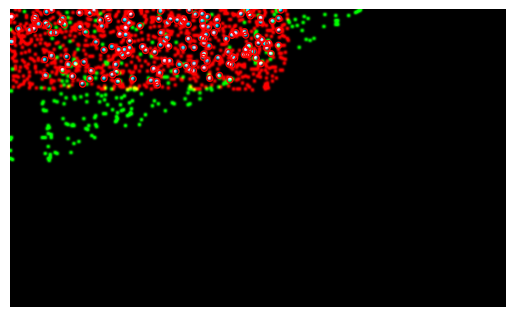

Working on: Pos00325

[ 10.16 -18.86]
Matched clusters before transform update:  296
Matched clusters after transform update:  310
Out of  1630  smFRET peaks and  1329  clusters
Percentage of matched smFRET peaks:  19
Percentage of matched clusters:  23


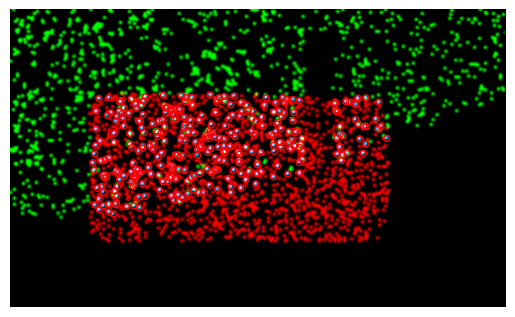

Working on: Pos00326

[  9.06 -20.05]
Matched clusters before transform update:  427
Matched clusters after transform update:  451
Out of  1590  smFRET peaks and  1797  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  25


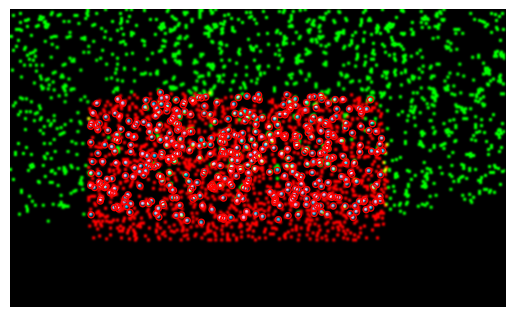

Working on: Pos00327

[  7.91 -21.85]
Matched clusters before transform update:  355
Matched clusters after transform update:  359
Out of  1593  smFRET peaks and  1507  clusters
Percentage of matched smFRET peaks:  22
Percentage of matched clusters:  23


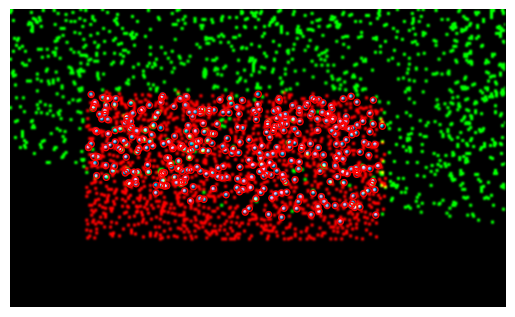

Working on: Pos00328

[-137.97  225.98]
Matched clusters before transform update:  91
Matched clusters after transform update:  133
Out of  1614  smFRET peaks and  862  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  15


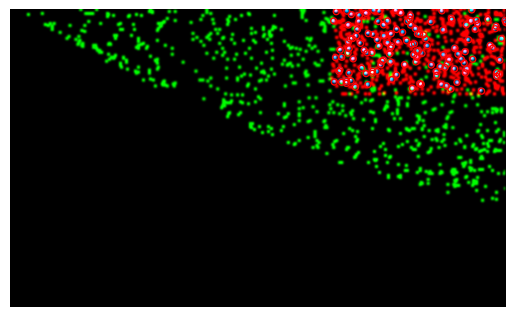

Working on: Pos00329

[-141.9  -222.08]
Not enough smFRET peaks (<4)
Working on: Pos00330

Working on: Pos00437

[-116.02  246.8 ]
Matched clusters before transform update:  40
Matched clusters after transform update:  64
Out of  1552  smFRET peaks and  114  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  56


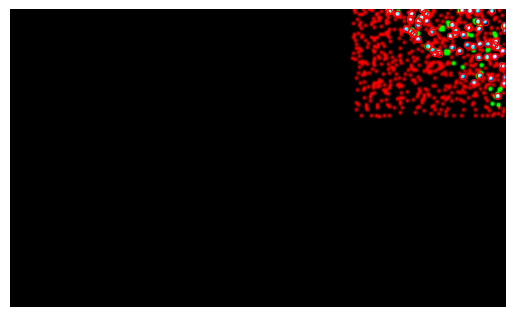

Working on: Pos00438

[  5.87 -27.55]
Matched clusters before transform update:  172
Matched clusters after transform update:  182
Out of  1619  smFRET peaks and  1127  clusters
Percentage of matched smFRET peaks:  11
Percentage of matched clusters:  16


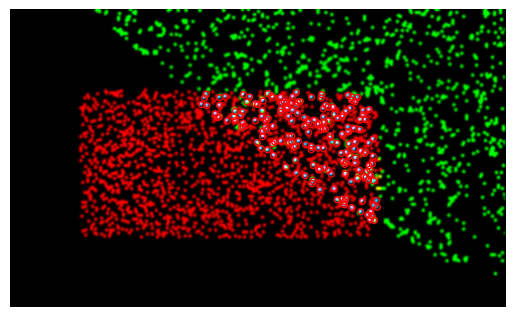

Working on: Pos00439

[  6.38 -25.06]
Matched clusters before transform update:  481
Matched clusters after transform update:  481
Out of  1610  smFRET peaks and  2148  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  22


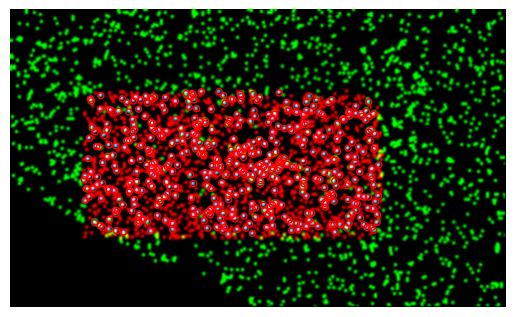

Working on: Pos00440

[  6.56 -24.36]
Matched clusters before transform update:  452
Matched clusters after transform update:  460
Out of  1568  smFRET peaks and  2417  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  19


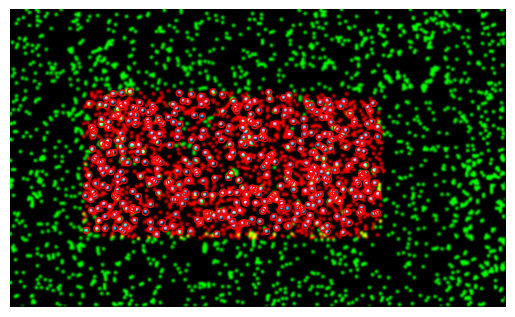

Working on: Pos00441

[  7.54 -22.9 ]
Matched clusters before transform update:  520
Matched clusters after transform update:  525
Out of  1625  smFRET peaks and  2567  clusters
Percentage of matched smFRET peaks:  32
Percentage of matched clusters:  20


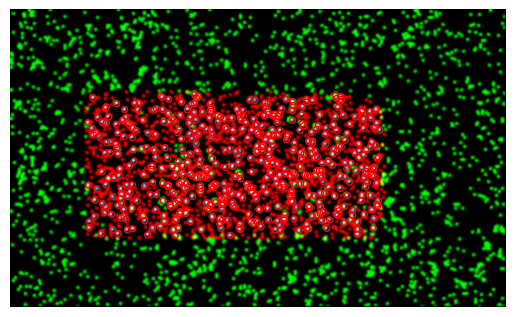

Working on: Pos00442

[  9.05 -21.8 ]
Matched clusters before transform update:  450
Matched clusters after transform update:  453
Out of  1582  smFRET peaks and  2463  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  18


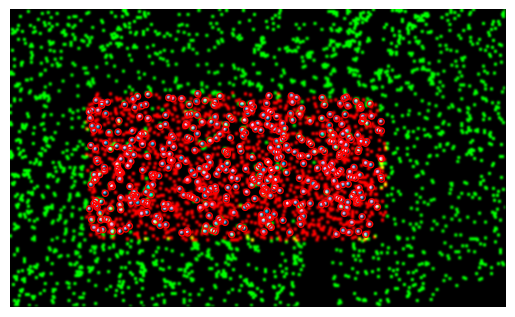

Working on: Pos00443

[ 10.15 -20.37]
Matched clusters before transform update:  425
Matched clusters after transform update:  431
Out of  1612  smFRET peaks and  1891  clusters
Percentage of matched smFRET peaks:  26
Percentage of matched clusters:  22


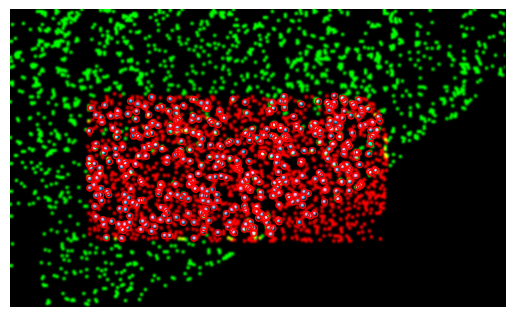

Working on: Pos00444

[-138.97 -167.96]
Matched clusters before transform update:  108
Matched clusters after transform update:  164
Out of  1578  smFRET peaks and  619  clusters
Percentage of matched smFRET peaks:  10
Percentage of matched clusters:  26


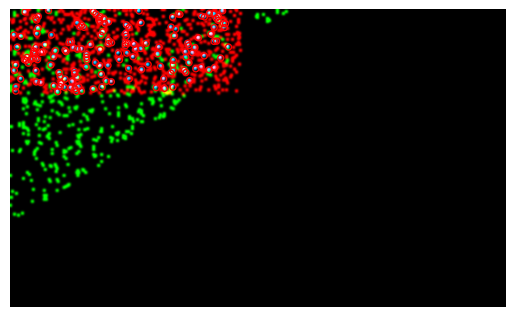

Working on: Pos00579

[  9.15 -13.97]
Matched clusters before transform update:  305
Matched clusters after transform update:  318
Out of  1645  smFRET peaks and  1564  clusters
Percentage of matched smFRET peaks:  19
Percentage of matched clusters:  20


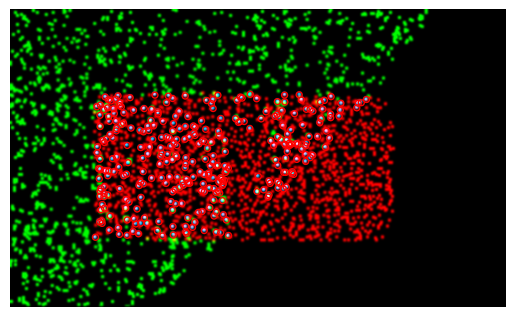

Working on: Pos00580

[  7.72 -16.19]
Matched clusters before transform update:  523
Matched clusters after transform update:  538
Out of  1636  smFRET peaks and  2700  clusters
Percentage of matched smFRET peaks:  32
Percentage of matched clusters:  19


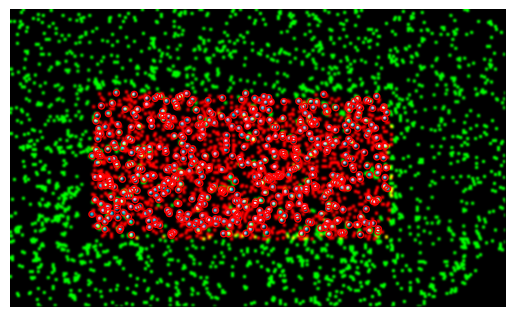

Working on: Pos00581

[  6.08 -16.62]
Matched clusters before transform update:  496
Matched clusters after transform update:  505
Out of  1627  smFRET peaks and  2500  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


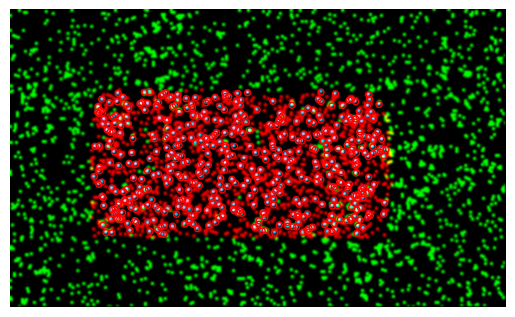

Working on: Pos00582

[  4.89 -17.55]
Matched clusters before transform update:  484
Matched clusters after transform update:  498
Out of  1606  smFRET peaks and  2376  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


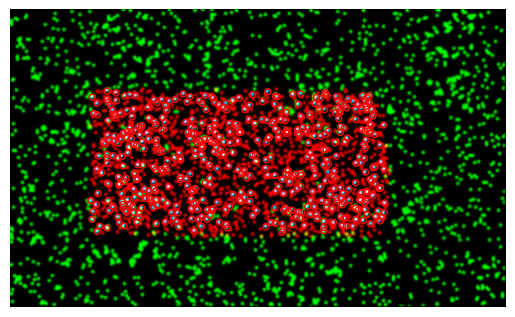

Working on: Pos00583

[  4.06 -18.83]
Matched clusters before transform update:  430
Matched clusters after transform update:  437
Out of  1567  smFRET peaks and  2472  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  17


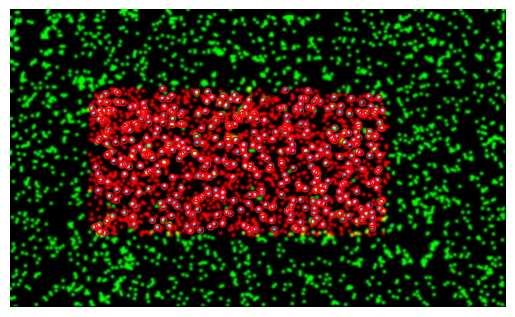

Working on: Pos00584

[  3.85 -18.9 ]
Matched clusters before transform update:  467
Matched clusters after transform update:  503
Out of  1612  smFRET peaks and  2611  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  19


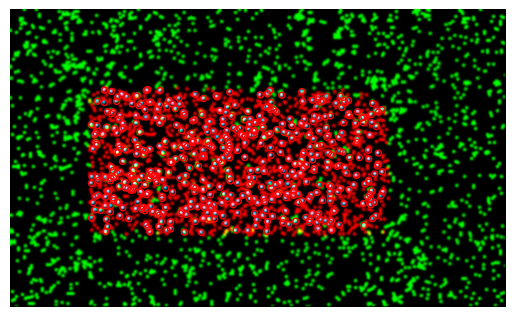

Working on: Pos00585

[  3.46 -21.22]
Matched clusters before transform update:  491
Matched clusters after transform update:  491
Out of  1581  smFRET peaks and  2340  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


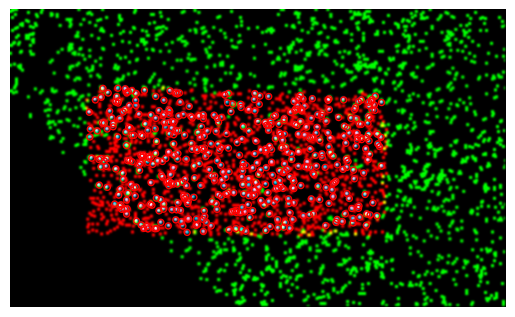

Working on: Pos00586

[-86.07 180.05]
Matched clusters before transform update:  209
Matched clusters after transform update:  283
Out of  1548  smFRET peaks and  765  clusters
Percentage of matched smFRET peaks:  18
Percentage of matched clusters:  36


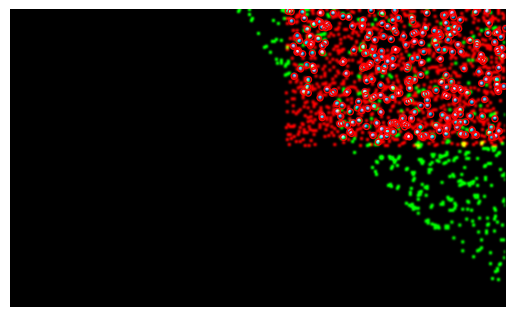

Working on: Pos00693

[  2.88 -27.79]
Matched clusters before transform update:  238
Matched clusters after transform update:  240
Out of  1581  smFRET peaks and  1475  clusters
Percentage of matched smFRET peaks:  15
Percentage of matched clusters:  16


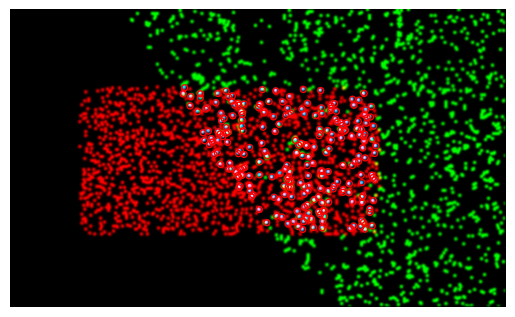

Working on: Pos00694

[  2.99 -24.35]
Matched clusters before transform update:  543
Matched clusters after transform update:  557
Out of  1630  smFRET peaks and  2628  clusters
Percentage of matched smFRET peaks:  34
Percentage of matched clusters:  21


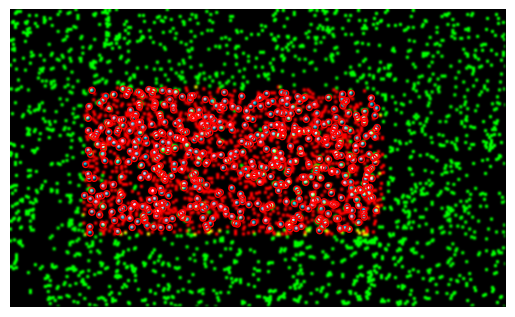

Working on: Pos00695

[  3.26 -22.6 ]
Matched clusters before transform update:  480
Matched clusters after transform update:  490
Out of  1601  smFRET peaks and  2522  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  19


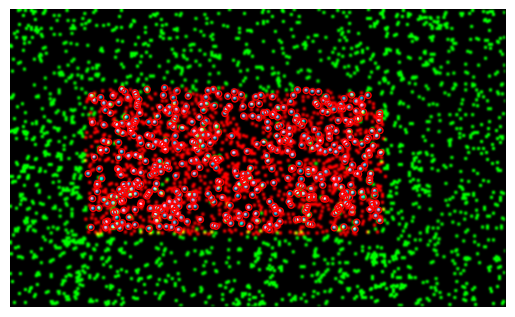

Working on: Pos00696

[  3.75 -22.06]
Matched clusters before transform update:  483
Matched clusters after transform update:  484
Out of  1565  smFRET peaks and  2474  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  19


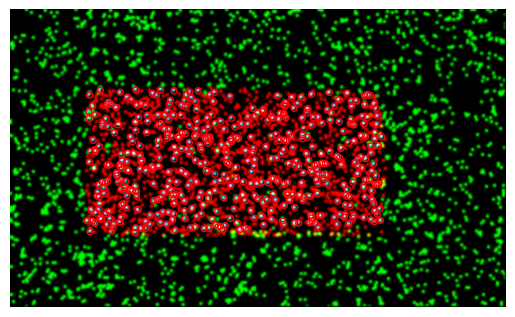

Working on: Pos00697

[  4.72 -20.74]
Matched clusters before transform update:  482
Matched clusters after transform update:  479
Out of  1662  smFRET peaks and  2460  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  19


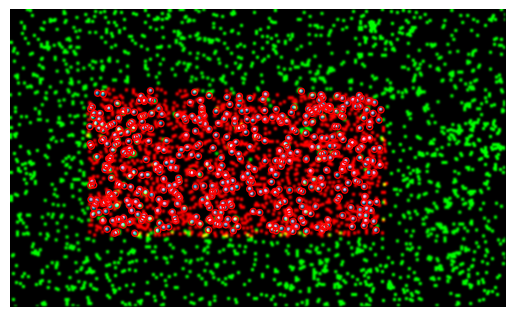

Working on: Pos00698

[  5.49 -20.52]
Matched clusters before transform update:  494
Matched clusters after transform update:  507
Out of  1614  smFRET peaks and  2426  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


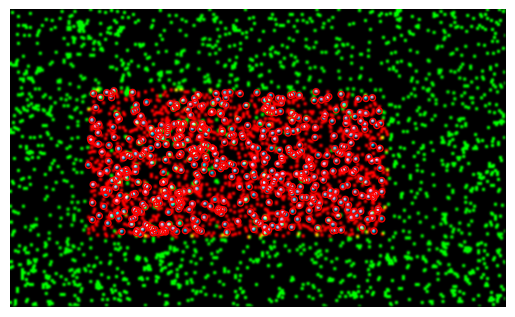

Working on: Pos00699

[  7.17 -19.77]
Matched clusters before transform update:  466
Matched clusters after transform update:  476
Out of  1579  smFRET peaks and  2338  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


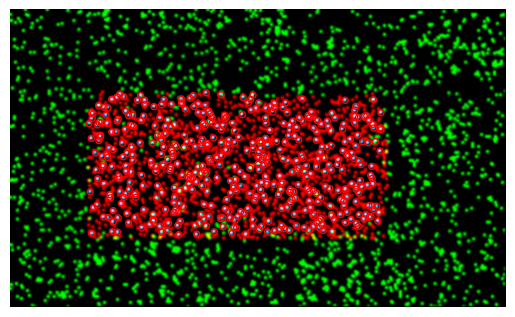

Working on: Pos00700

[  8.85 -18.53]
Matched clusters before transform update:  463
Matched clusters after transform update:  464
Out of  1625  smFRET peaks and  2147  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  21


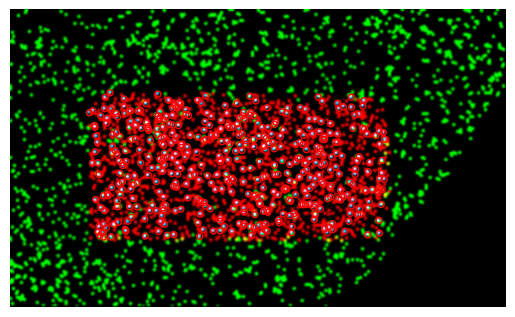

Working on: Pos00835

[  7.07 -14.33]
Matched clusters before transform update:  469
Matched clusters after transform update:  481
Out of  1625  smFRET peaks and  2393  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


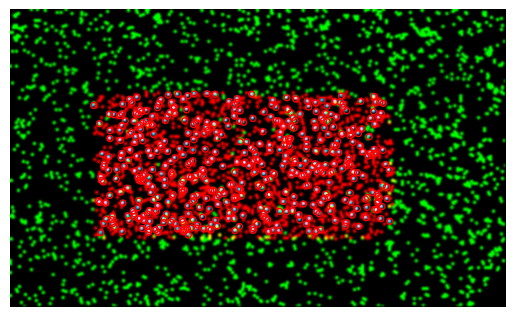

Working on: Pos00836

[  5.48 -15.22]
Matched clusters before transform update:  460
Matched clusters after transform update:  476
Out of  1605  smFRET peaks and  2203  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  21


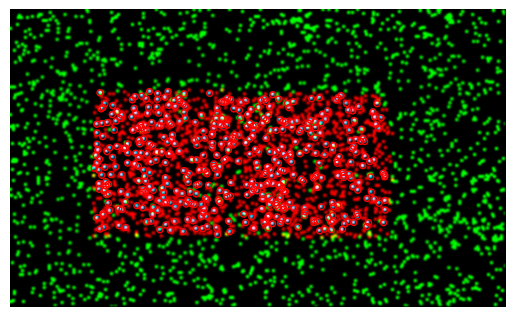

Working on: Pos00837

[  4.21 -15.3 ]
Matched clusters before transform update:  489
Matched clusters after transform update:  488
Out of  1640  smFRET peaks and  2346  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


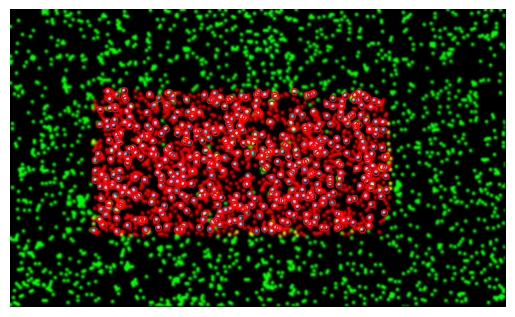

Working on: Pos00838

[  3.09 -15.64]
Matched clusters before transform update:  489
Matched clusters after transform update:  496
Out of  1628  smFRET peaks and  2301  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


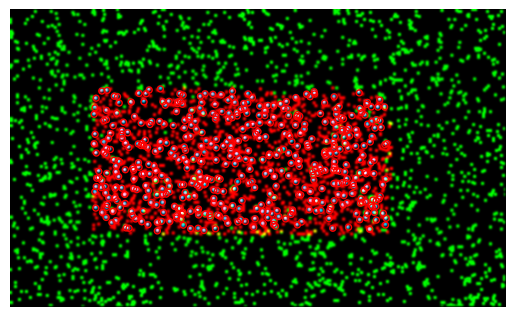

Working on: Pos00839

[  1.85 -16.92]
Matched clusters before transform update:  499
Matched clusters after transform update:  502
Out of  1636  smFRET peaks and  2444  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


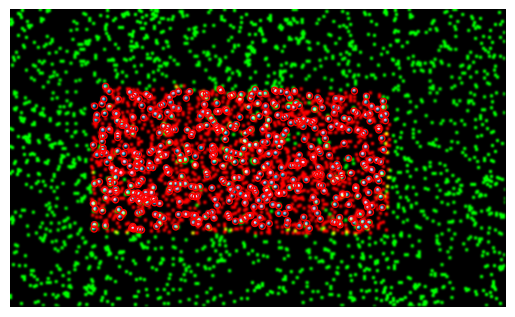

Working on: Pos00840

[  1.81 -16.72]
Matched clusters before transform update:  468
Matched clusters after transform update:  477
Out of  1640  smFRET peaks and  2523  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  18


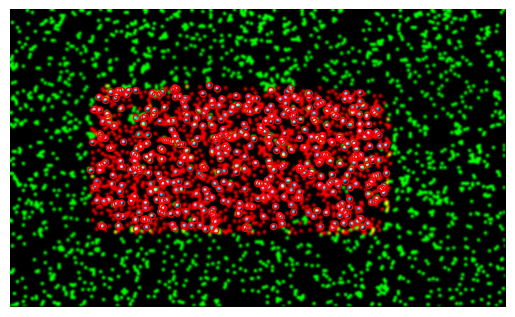

Working on: Pos00841

[  1.66 -18.92]
Matched clusters before transform update:  487
Matched clusters after transform update:  507
Out of  1605  smFRET peaks and  2596  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  19


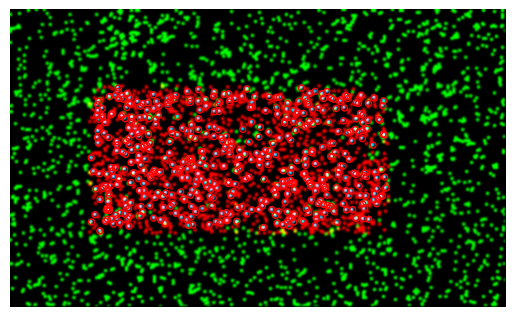

Working on: Pos00842

[  1.   -21.39]
Matched clusters before transform update:  450
Matched clusters after transform update:  460
Out of  1648  smFRET peaks and  2037  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  22


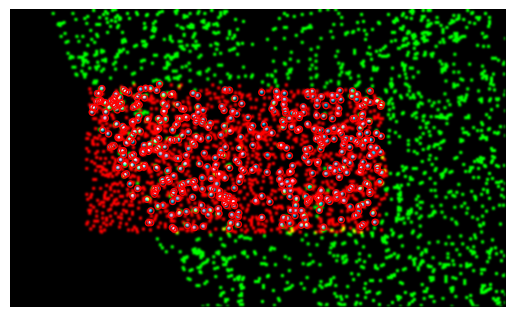

Working on: Pos00949

[  1.15 -24.32]
Matched clusters before transform update:  491
Matched clusters after transform update:  497
Out of  1631  smFRET peaks and  2465  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


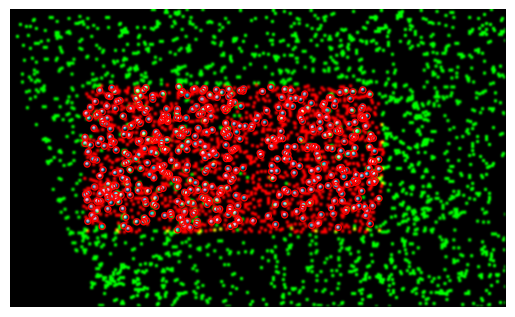

Working on: Pos00950

[  1.68 -21.61]
Matched clusters before transform update:  514
Matched clusters after transform update:  512
Out of  1626  smFRET peaks and  2667  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  19


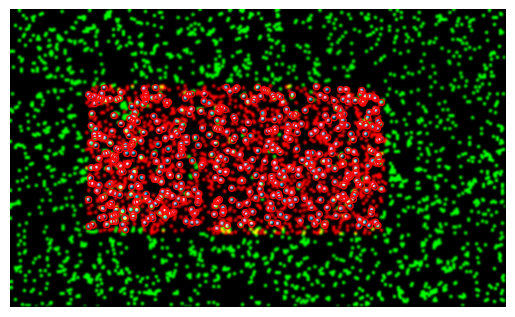

Working on: Pos00951

[  2.3  -19.61]
Matched clusters before transform update:  500
Matched clusters after transform update:  503
Out of  1604  smFRET peaks and  2486  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


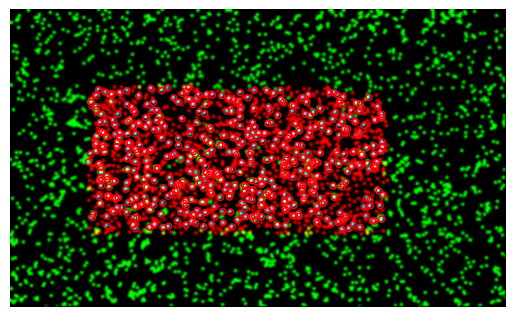

Working on: Pos00952

[  3.21 -19.67]
Matched clusters before transform update:  476
Matched clusters after transform update:  482
Out of  1650  smFRET peaks and  2357  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


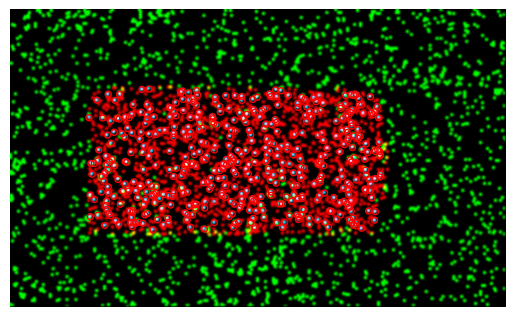

Working on: Pos00953

[  4.1  -19.06]
Matched clusters before transform update:  424
Matched clusters after transform update:  439
Out of  1568  smFRET peaks and  2397  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  18


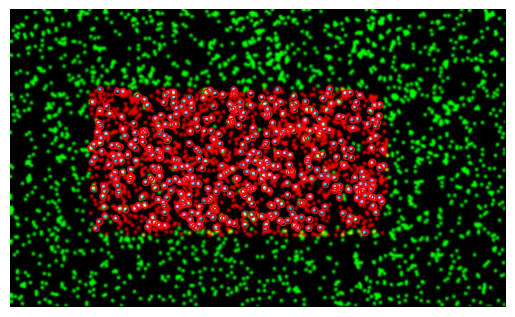

Working on: Pos00954

[  4.99 -19.18]
Matched clusters before transform update:  506
Matched clusters after transform update:  528
Out of  1703  smFRET peaks and  2387  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  22


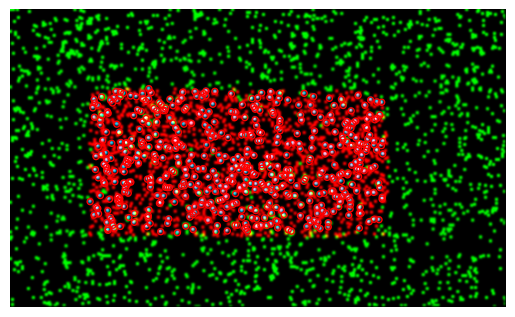

Working on: Pos00955

[  6.72 -18.51]
Matched clusters before transform update:  475
Matched clusters after transform update:  480
Out of  1673  smFRET peaks and  2320  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  20


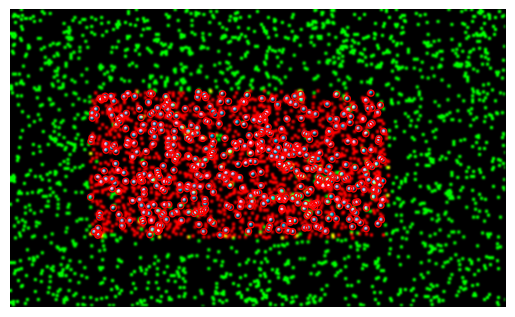

Working on: Pos00956

[  7.97 -17.23]
Matched clusters before transform update:  498
Matched clusters after transform update:  507
Out of  1592  smFRET peaks and  2512  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


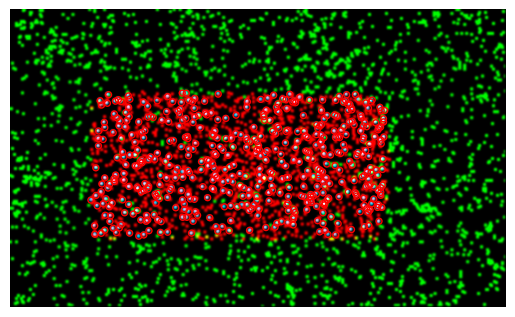

Working on: Pos01091

[  6.47 -12.66]
Matched clusters before transform update:  523
Matched clusters after transform update:  534
Out of  1651  smFRET peaks and  2596  clusters
Percentage of matched smFRET peaks:  32
Percentage of matched clusters:  20


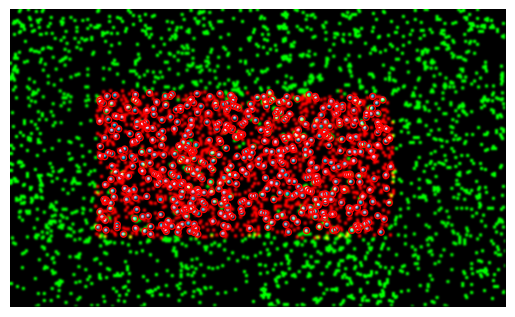

Working on: Pos01092

[  5.13 -13.3 ]
Matched clusters before transform update:  510
Matched clusters after transform update:  526
Out of  1673  smFRET peaks and  2450  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  21


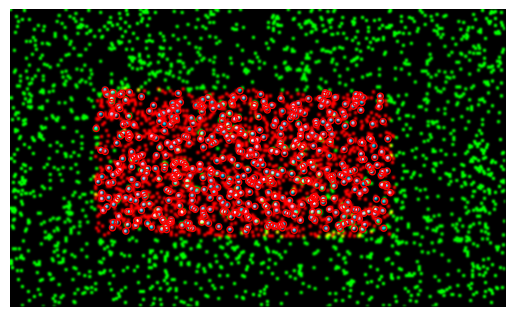

Working on: Pos01093

[  4.05 -13.71]
Matched clusters before transform update:  505
Matched clusters after transform update:  520
Out of  1635  smFRET peaks and  2465  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  21


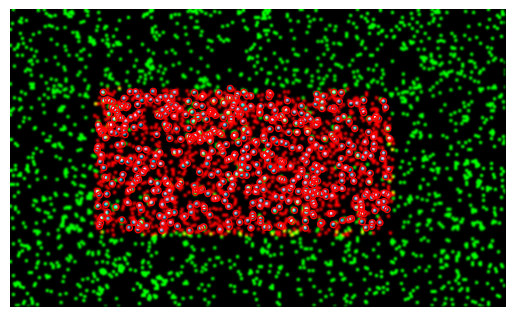

Working on: Pos01094

[  3.19 -13.94]
Matched clusters before transform update:  475
Matched clusters after transform update:  480
Out of  1677  smFRET peaks and  2510  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  19


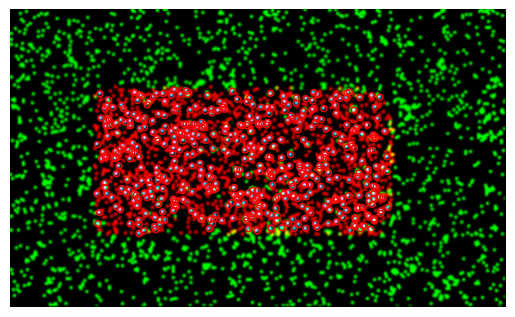

Working on: Pos01095

[  1.87 -14.85]
Matched clusters before transform update:  492
Matched clusters after transform update:  498
Out of  1602  smFRET peaks and  2379  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


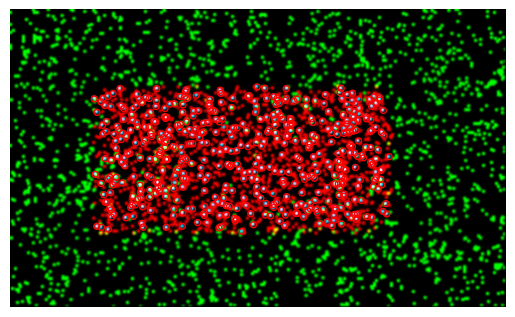

Working on: Pos01096

[  0.93 -14.13]
Matched clusters before transform update:  496
Matched clusters after transform update:  502
Out of  1627  smFRET peaks and  2247  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  22


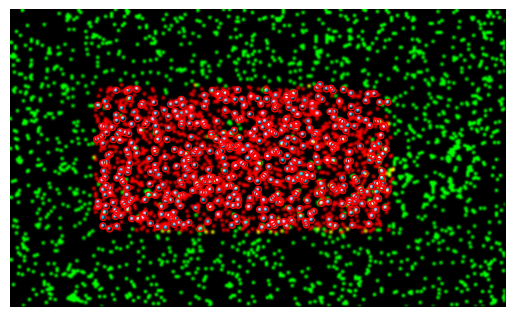

Working on: Pos01097

[  0.46 -16.28]
Matched clusters before transform update:  499
Matched clusters after transform update:  512
Out of  1649  smFRET peaks and  2453  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


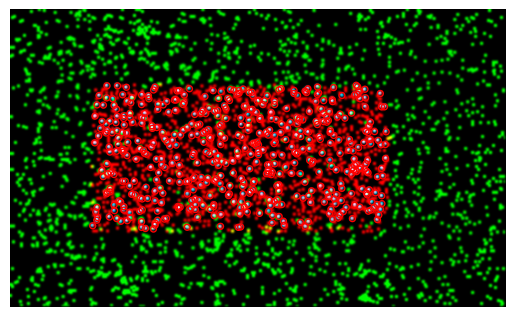

Working on: Pos01098

[ -0.54 -19.1 ]
Matched clusters before transform update:  433
Matched clusters after transform update:  446
Out of  1636  smFRET peaks and  2546  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  17


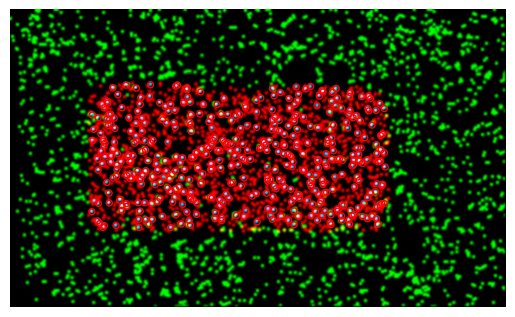

Working on: Pos01205

[ -1.03 -21.95]
Matched clusters before transform update:  427
Matched clusters after transform update:  429
Out of  1658  smFRET peaks and  2355  clusters
Percentage of matched smFRET peaks:  25
Percentage of matched clusters:  18


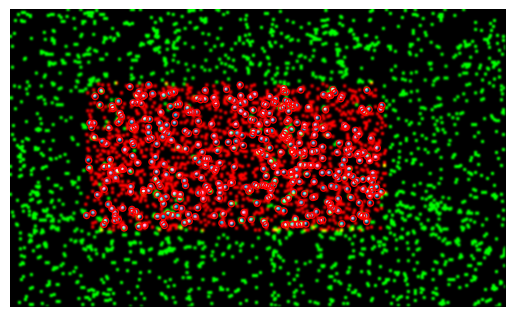

Working on: Pos01206

[ -0.45 -19.33]
Matched clusters before transform update:  445
Matched clusters after transform update:  445
Out of  1609  smFRET peaks and  2267  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  19


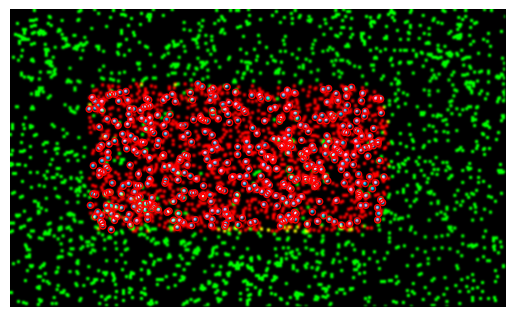

Working on: Pos01207

[  0.68 -17.69]
Matched clusters before transform update:  464
Matched clusters after transform update:  481
Out of  1627  smFRET peaks and  2322  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


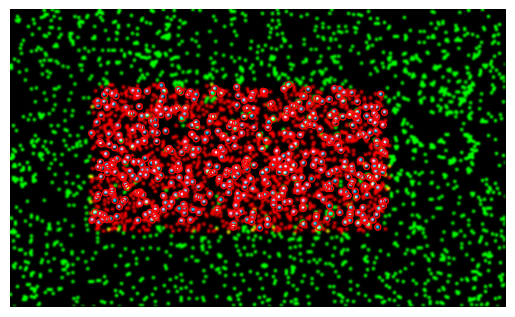

Working on: Pos01208

[  1.7  -17.29]
Matched clusters before transform update:  483
Matched clusters after transform update:  492
Out of  1656  smFRET peaks and  2490  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  19


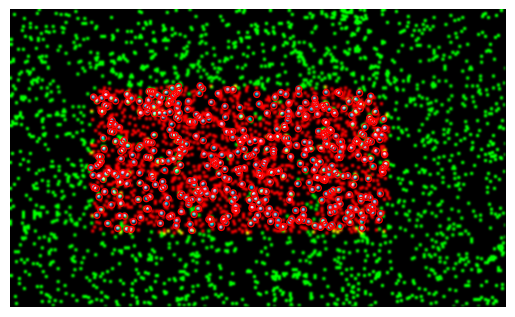

Working on: Pos01209

[  2.73 -17.15]
Matched clusters before transform update:  495
Matched clusters after transform update:  503
Out of  1652  smFRET peaks and  2473  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


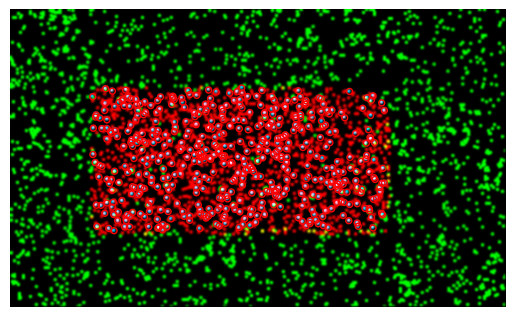

Working on: Pos01210

[  4.22 -17.  ]
Matched clusters before transform update:  476
Matched clusters after transform update:  507
Out of  1606  smFRET peaks and  2464  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


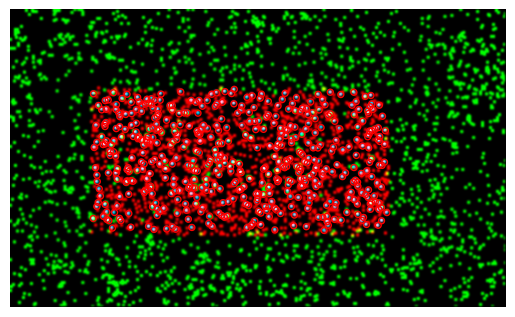

Working on: Pos01211

[  5.01 -16.44]
Matched clusters before transform update:  485
Matched clusters after transform update:  494
Out of  1649  smFRET peaks and  2414  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


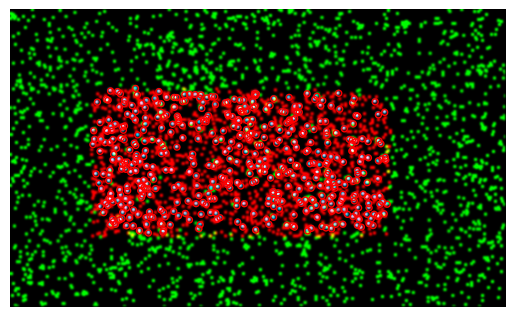

Working on: Pos01212

[  6.21 -16.12]
Matched clusters before transform update:  492
Matched clusters after transform update:  511
Out of  1670  smFRET peaks and  2532  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


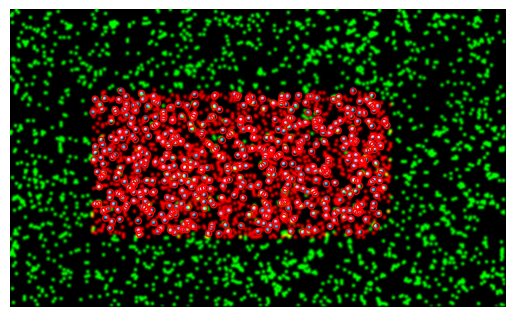

Working on: Pos01347

[  5.68 -10.62]
Matched clusters before transform update:  483
Matched clusters after transform update:  495
Out of  1622  smFRET peaks and  2368  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


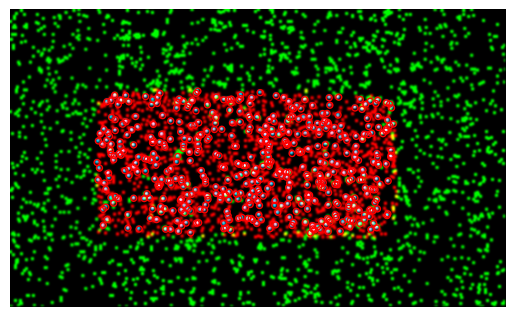

Working on: Pos01348

[  4.53 -11.26]
Matched clusters before transform update:  478
Matched clusters after transform update:  494
Out of  1643  smFRET peaks and  2337  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


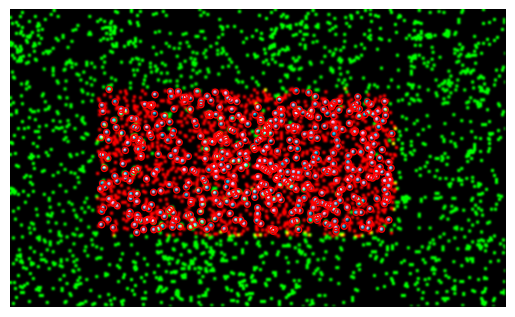

Working on: Pos01349

[  3.46 -11.52]
Matched clusters before transform update:  467
Matched clusters after transform update:  483
Out of  1585  smFRET peaks and  2323  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


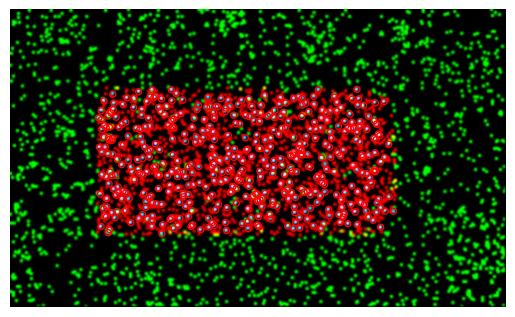

Working on: Pos01350

[  2.72 -11.4 ]
Matched clusters before transform update:  459
Matched clusters after transform update:  468
Out of  1601  smFRET peaks and  2401  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  19


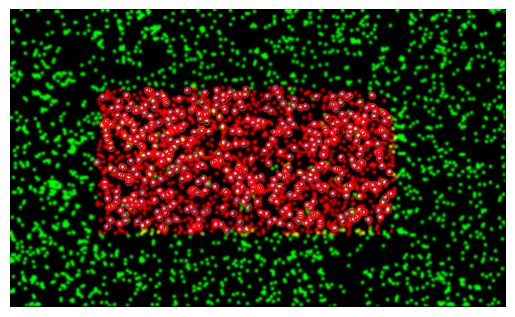

Working on: Pos01351

[  1.65 -12.38]
Matched clusters before transform update:  475
Matched clusters after transform update:  496
Out of  1597  smFRET peaks and  2490  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  19


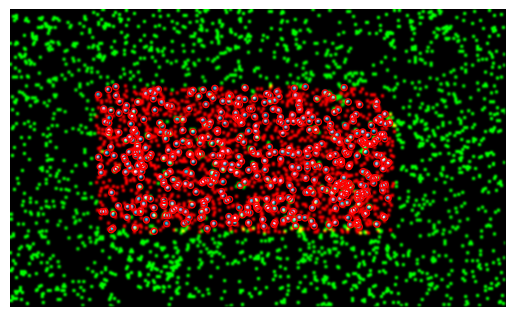

Working on: Pos01352

[  0.45 -11.92]
Matched clusters before transform update:  449
Matched clusters after transform update:  465
Out of  1652  smFRET peaks and  2380  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  19


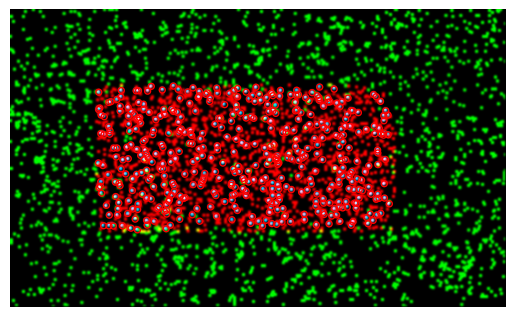

Working on: Pos01353

[ -0.83 -13.82]
Matched clusters before transform update:  527
Matched clusters after transform update:  532
Out of  1638  smFRET peaks and  2404  clusters
Percentage of matched smFRET peaks:  32
Percentage of matched clusters:  22


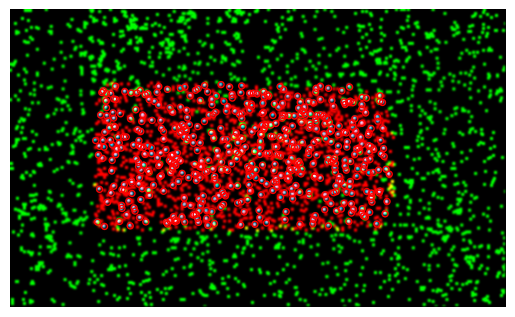

Working on: Pos01354

[ -2.47 -16.07]
Matched clusters before transform update:  464
Matched clusters after transform update:  486
Out of  1677  smFRET peaks and  2429  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  20


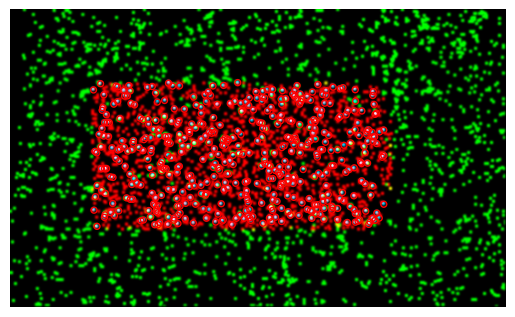

Working on: Pos01461

[ -2.31 -19.4 ]
Matched clusters before transform update:  461
Matched clusters after transform update:  479
Out of  1621  smFRET peaks and  2488  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  19


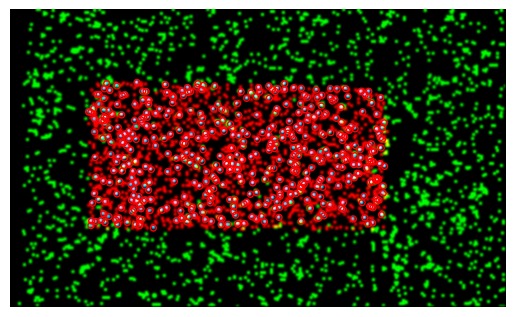

Working on: Pos01462

[ -0.83 -16.8 ]
Matched clusters before transform update:  493
Matched clusters after transform update:  508
Out of  1648  smFRET peaks and  2522  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


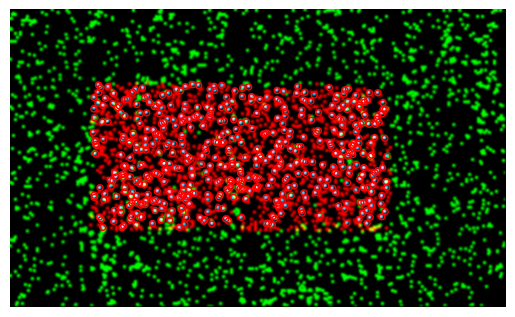

Working on: Pos01463

[  0.56 -14.88]
Matched clusters before transform update:  480
Matched clusters after transform update:  488
Out of  1664  smFRET peaks and  2420  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


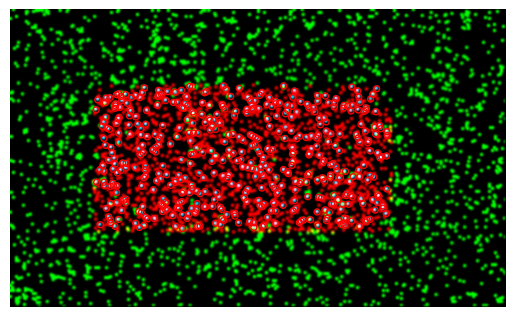

Working on: Pos01464

[  1.74 -15.38]
Matched clusters before transform update:  534
Matched clusters after transform update:  559
Out of  1684  smFRET peaks and  2505  clusters
Percentage of matched smFRET peaks:  33
Percentage of matched clusters:  22


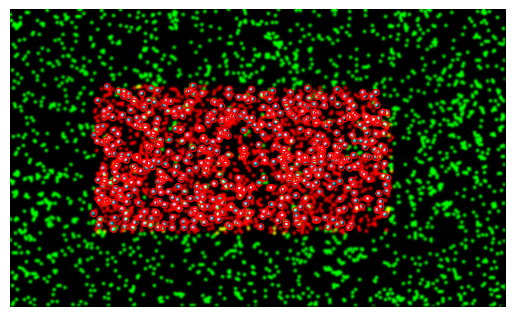

Working on: Pos01465

[  2.98 -14.76]
Matched clusters before transform update:  506
Matched clusters after transform update:  527
Out of  1600  smFRET peaks and  2415  clusters
Percentage of matched smFRET peaks:  32
Percentage of matched clusters:  21


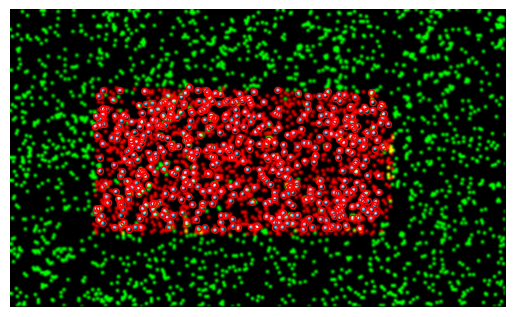

Working on: Pos01466

[  4.02 -13.92]
Matched clusters before transform update:  462
Matched clusters after transform update:  480
Out of  1611  smFRET peaks and  2322  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


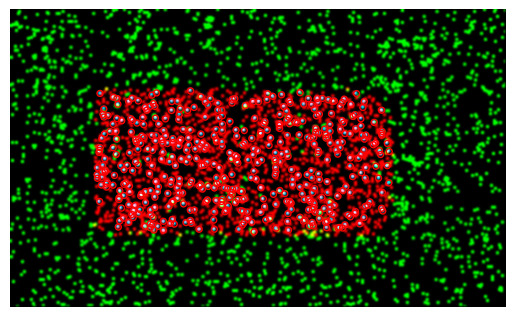

Working on: Pos01467

[  4.97 -14.24]
Matched clusters before transform update:  490
Matched clusters after transform update:  492
Out of  1591  smFRET peaks and  2339  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


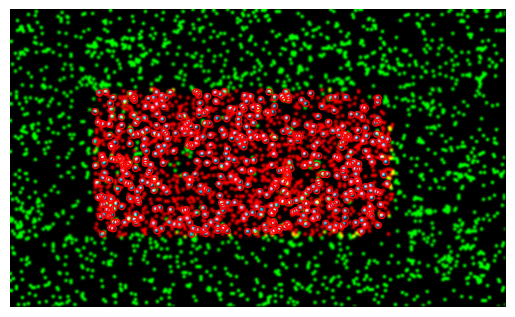

Working on: Pos01468

[  5.97 -13.52]
Matched clusters before transform update:  476
Matched clusters after transform update:  496
Out of  1640  smFRET peaks and  2355  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


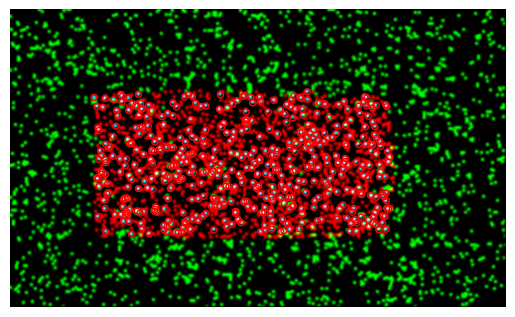

Working on: Pos01603

[ 4.69 -7.65]
Matched clusters before transform update:  484
Matched clusters after transform update:  478
Out of  1681  smFRET peaks and  2438  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  19


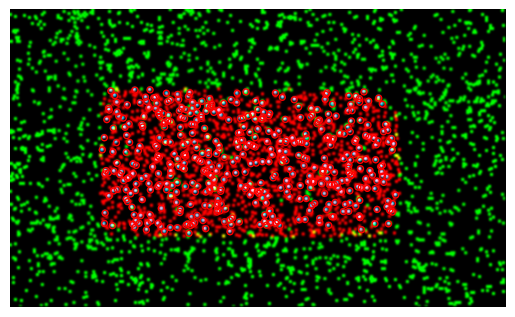

Working on: Pos01604

[ 3.78 -8.69]
Matched clusters before transform update:  521
Matched clusters after transform update:  535
Out of  1659  smFRET peaks and  2506  clusters
Percentage of matched smFRET peaks:  32
Percentage of matched clusters:  21


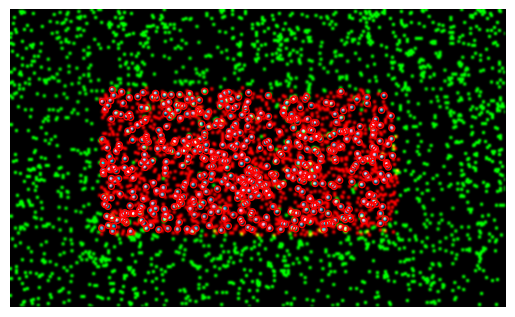

Working on: Pos01605

[ 2.93 -9.25]
Matched clusters before transform update:  463
Matched clusters after transform update:  475
Out of  1675  smFRET peaks and  2331  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  20


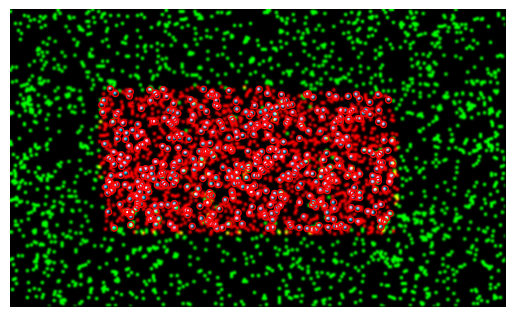

Working on: Pos01606

[ 1.47 -9.28]
Matched clusters before transform update:  498
Matched clusters after transform update:  501
Out of  1638  smFRET peaks and  2453  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


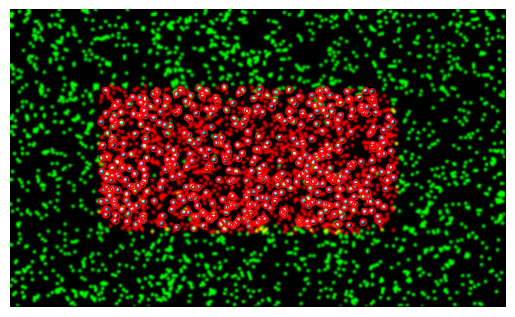

Working on: Pos01607

[ 0.3  -9.93]
Matched clusters before transform update:  476
Matched clusters after transform update:  489
Out of  1637  smFRET peaks and  2545  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  19


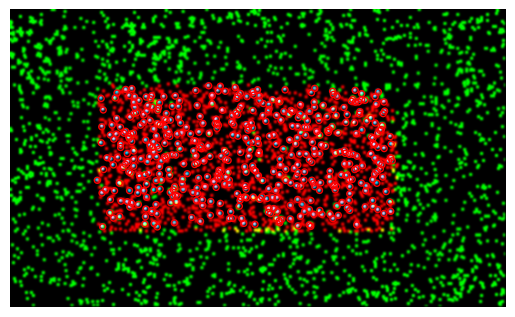

Working on: Pos01608

[-1.15 -9.51]
Matched clusters before transform update:  469
Matched clusters after transform update:  486
Out of  1627  smFRET peaks and  2595  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  18


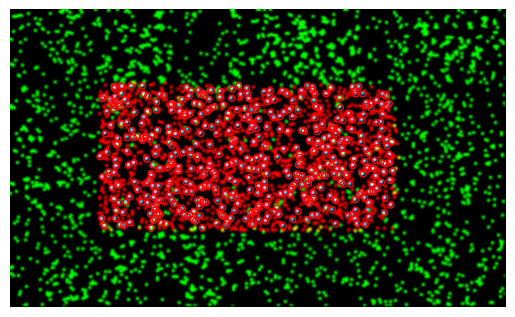

Working on: Pos01609

[ -2.27 -11.58]
Matched clusters before transform update:  449
Matched clusters after transform update:  458
Out of  1666  smFRET peaks and  2414  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  18


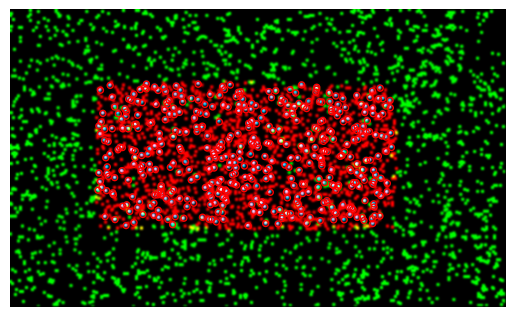

Working on: Pos01610

[ -4.09 -14.14]
Matched clusters before transform update:  463
Matched clusters after transform update:  474
Out of  1645  smFRET peaks and  2313  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  20


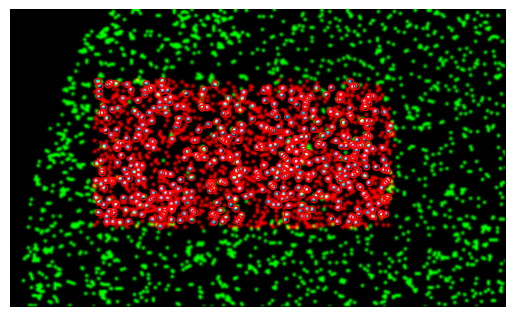

Working on: Pos01717

[ -5.17 -17.69]
Matched clusters before transform update:  474
Matched clusters after transform update:  481
Out of  1670  smFRET peaks and  2060  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  23


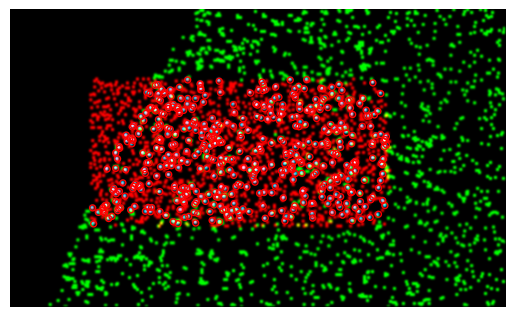

Working on: Pos01718

[ -3.13 -14.49]
Matched clusters before transform update:  452
Matched clusters after transform update:  459
Out of  1642  smFRET peaks and  2467  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  18


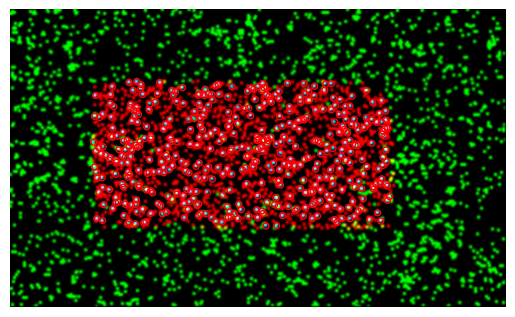

Working on: Pos01719

[ -1.95 -13.07]
Matched clusters before transform update:  509
Matched clusters after transform update:  502
Out of  1608  smFRET peaks and  2696  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  18


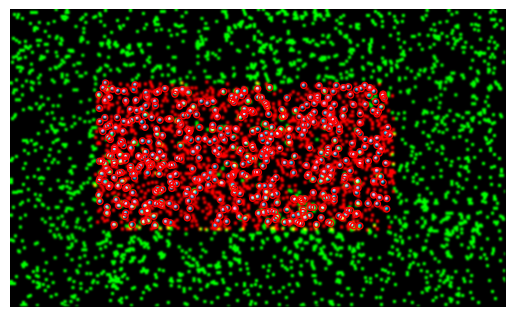

Working on: Pos01720

[  0.04 -13.01]
Matched clusters before transform update:  495
Matched clusters after transform update:  510
Out of  1673  smFRET peaks and  2594  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  19


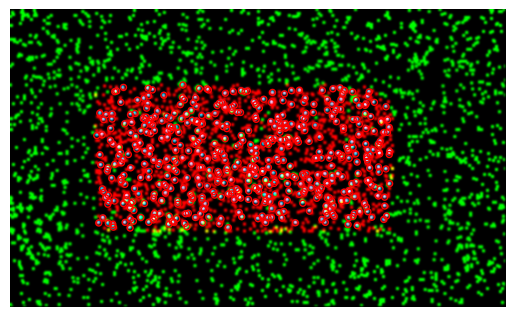

Working on: Pos01721

[  0.92 -12.34]
Matched clusters before transform update:  514
Matched clusters after transform update:  520
Out of  1700  smFRET peaks and  2476  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


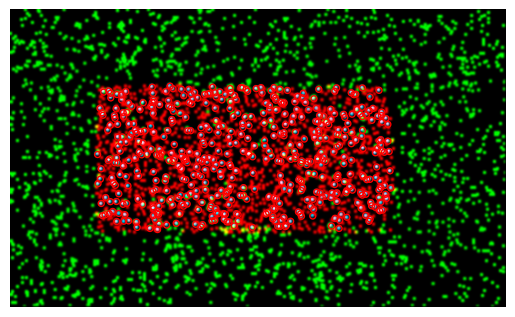

Working on: Pos01722

[  2.51 -12.06]
Matched clusters before transform update:  503
Matched clusters after transform update:  508
Out of  1732  smFRET peaks and  2350  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  21


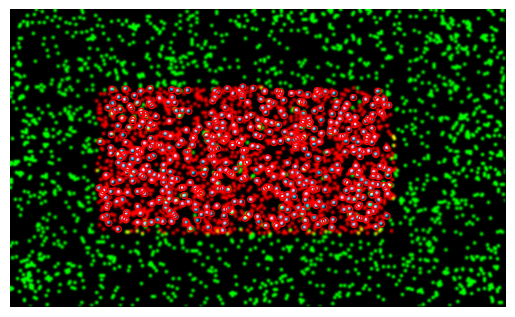

Working on: Pos01723

[  3.14 -11.66]
Matched clusters before transform update:  552
Matched clusters after transform update:  543
Out of  1738  smFRET peaks and  2579  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  21


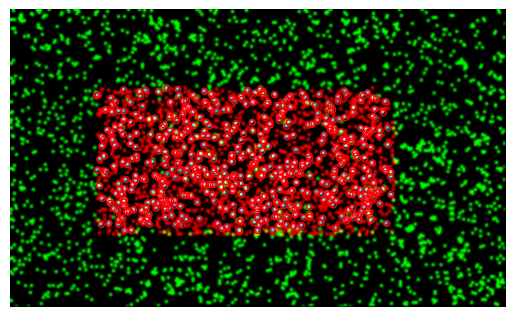

Working on: Pos01724

[  3.87 -10.35]
Matched clusters before transform update:  504
Matched clusters after transform update:  519
Out of  1684  smFRET peaks and  2522  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


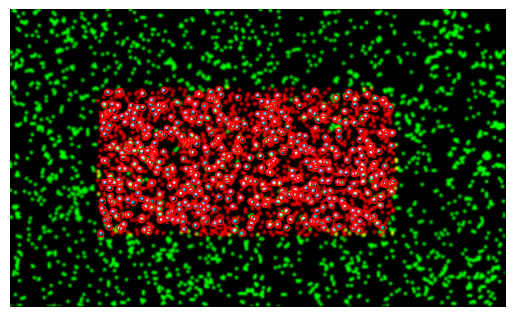

Working on: Pos01859

[ 2.06 -4.81]
Matched clusters before transform update:  470
Matched clusters after transform update:  465
Out of  1646  smFRET peaks and  2086  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  22


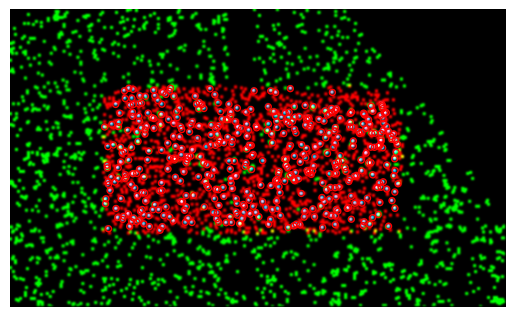

Working on: Pos01860

[ 1.8 -6.4]
Matched clusters before transform update:  495
Matched clusters after transform update:  493
Out of  1647  smFRET peaks and  2434  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  20


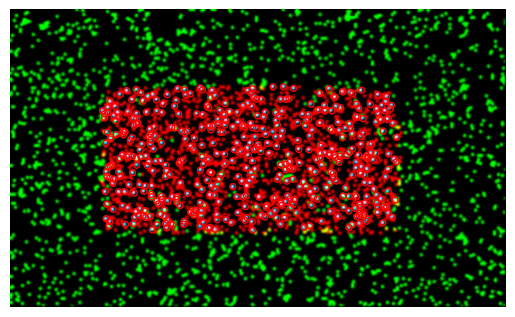

Working on: Pos01861

[ 1.12 -6.37]
Matched clusters before transform update:  498
Matched clusters after transform update:  519
Out of  1637  smFRET peaks and  2473  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


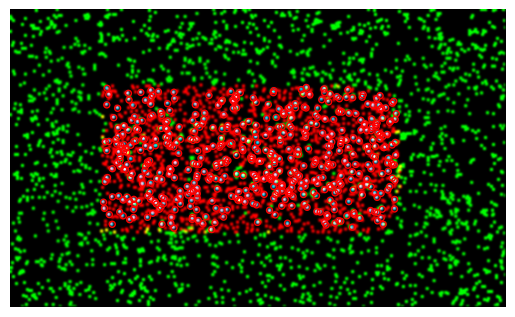

Working on: Pos01862

[-0.34 -7.36]
Matched clusters before transform update:  492
Matched clusters after transform update:  507
Out of  1652  smFRET peaks and  2487  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


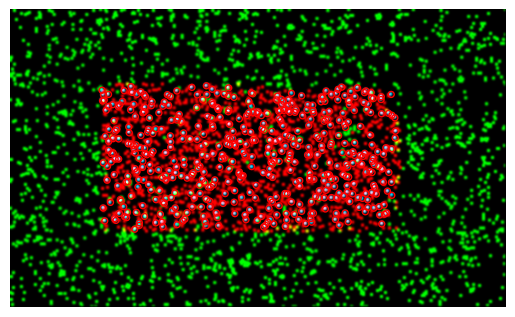

Working on: Pos01863

[-1.84 -7.79]
Matched clusters before transform update:  513
Matched clusters after transform update:  522
Out of  1674  smFRET peaks and  2463  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  21


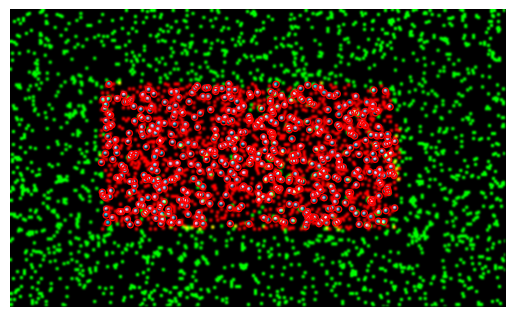

Working on: Pos01864

[-3.47 -8.06]
Matched clusters before transform update:  507
Matched clusters after transform update:  506
Out of  1641  smFRET peaks and  2448  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


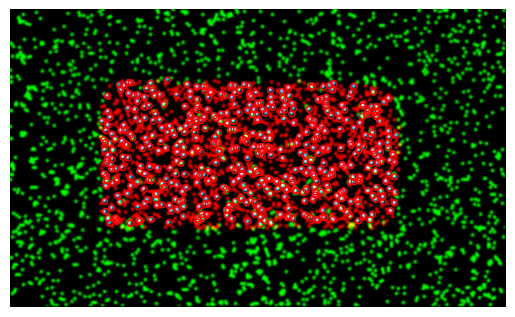

Working on: Pos01865

[-5.37 -9.99]
Matched clusters before transform update:  501
Matched clusters after transform update:  509
Out of  1664  smFRET peaks and  2555  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  19


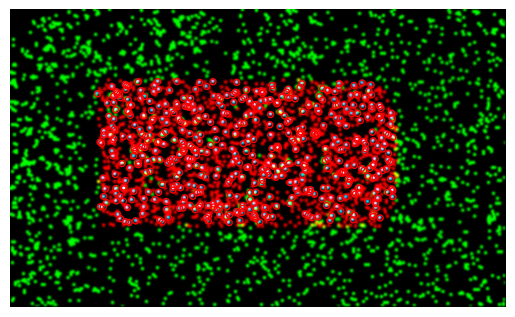

Working on: Pos01866

[ -6.89 -13.18]
Matched clusters before transform update:  303
Matched clusters after transform update:  301
Out of  1649  smFRET peaks and  1661  clusters
Percentage of matched smFRET peaks:  18
Percentage of matched clusters:  18


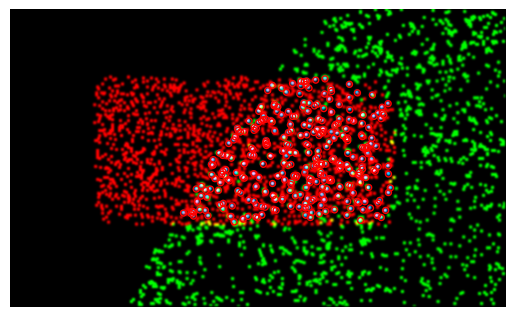

Working on: Pos01973

[ 27.94 189.88]
Matched clusters before transform update:  185
Matched clusters after transform update:  273
Out of  1673  smFRET peaks and  867  clusters
Percentage of matched smFRET peaks:  16
Percentage of matched clusters:  31


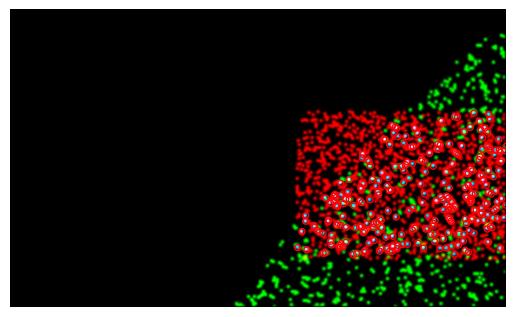

Working on: Pos01974

[ -5.79 -13.58]
Matched clusters before transform update:  466
Matched clusters after transform update:  489
Out of  1579  smFRET peaks and  2211  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  22


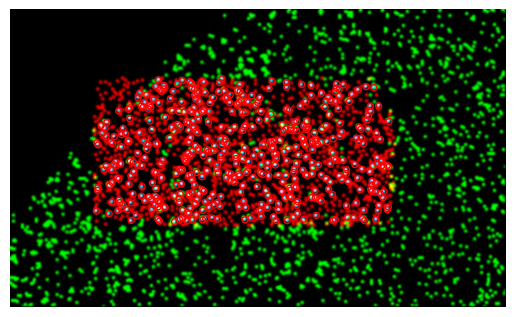

Working on: Pos01975

[ -4.71 -11.84]
Matched clusters before transform update:  475
Matched clusters after transform update:  484
Out of  1658  smFRET peaks and  2269  clusters
Percentage of matched smFRET peaks:  29
Percentage of matched clusters:  21


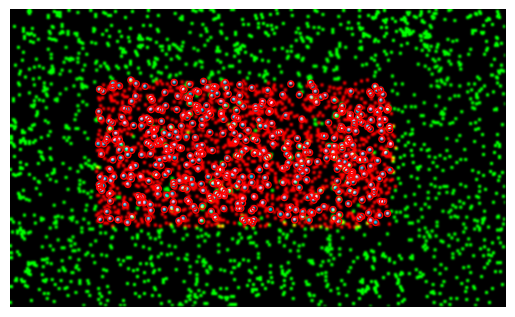

Working on: Pos01976

[ -2.55 -11.44]
Matched clusters before transform update:  499
Matched clusters after transform update:  512
Out of  1661  smFRET peaks and  2376  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


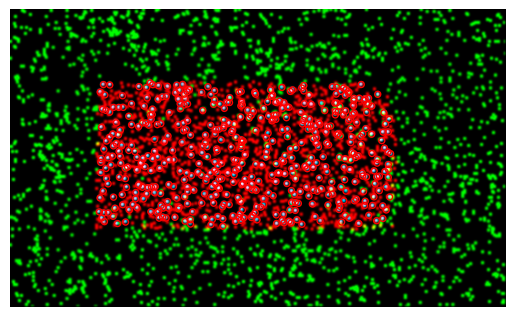

Working on: Pos01977

[ -1.27 -10.62]
Matched clusters before transform update:  492
Matched clusters after transform update:  504
Out of  1640  smFRET peaks and  2420  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  20


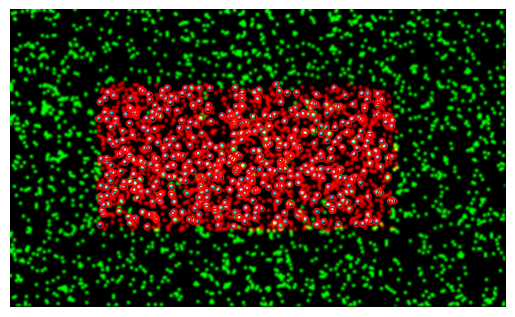

Working on: Pos01978

[-0.03 -9.79]
Matched clusters before transform update:  498
Matched clusters after transform update:  504
Out of  1674  smFRET peaks and  2383  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  21


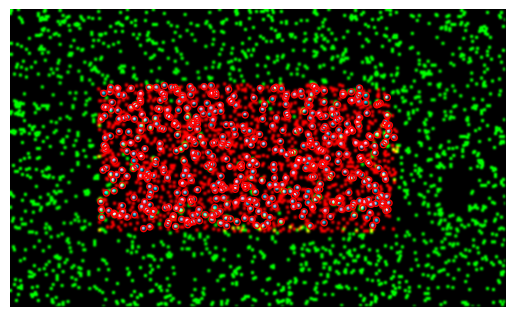

Working on: Pos01979

[ 1.15 -9.18]
Matched clusters before transform update:  473
Matched clusters after transform update:  476
Out of  1642  smFRET peaks and  2441  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  19


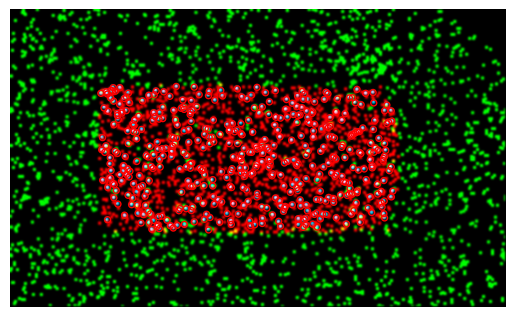

Working on: Pos01980

[ 1.58 -7.96]
Matched clusters before transform update:  321
Matched clusters after transform update:  321
Out of  1696  smFRET peaks and  1406  clusters
Percentage of matched smFRET peaks:  18
Percentage of matched clusters:  22


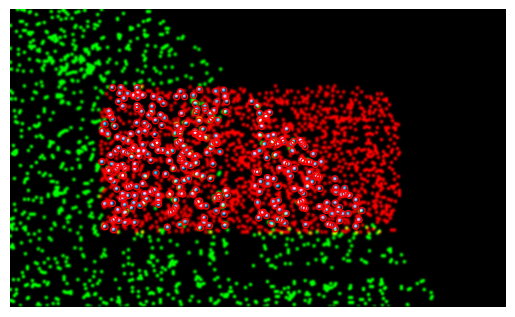

Working on: Pos02115

[  65.17 -196.03]
Matched clusters before transform update:  142
Matched clusters after transform update:  229
Out of  1568  smFRET peaks and  561  clusters
Percentage of matched smFRET peaks:  14
Percentage of matched clusters:  40


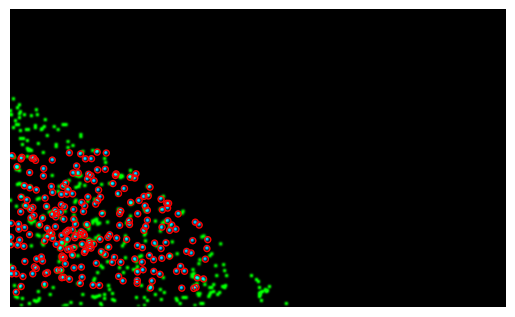

Working on: Pos02116

[-1.26 -3.1 ]
Matched clusters before transform update:  421
Matched clusters after transform update:  435
Out of  1595  smFRET peaks and  1771  clusters
Percentage of matched smFRET peaks:  27
Percentage of matched clusters:  24


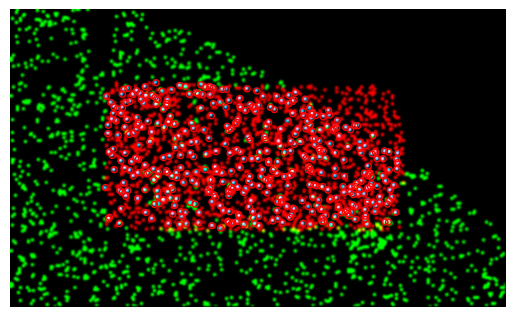

Working on: Pos02117

[-1.85 -4.53]
Matched clusters before transform update:  493
Matched clusters after transform update:  507
Out of  1617  smFRET peaks and  2359  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  21


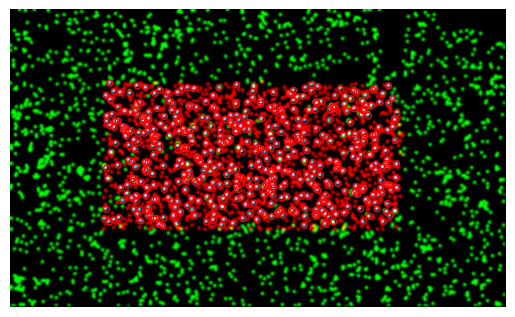

Working on: Pos02118

[-3.29 -5.4 ]
Matched clusters before transform update:  482
Matched clusters after transform update:  479
Out of  1562  smFRET peaks and  2461  clusters
Percentage of matched smFRET peaks:  30
Percentage of matched clusters:  19


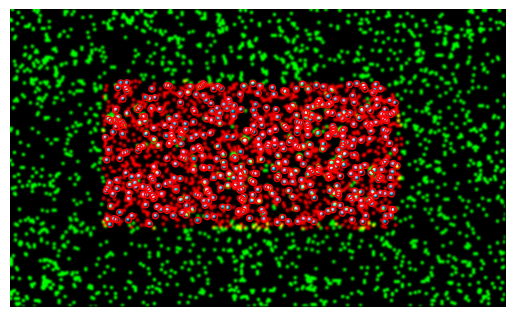

Working on: Pos02119

[-4.8  -6.77]
Matched clusters before transform update:  495
Matched clusters after transform update:  489
Out of  1573  smFRET peaks and  2333  clusters
Percentage of matched smFRET peaks:  31
Percentage of matched clusters:  20


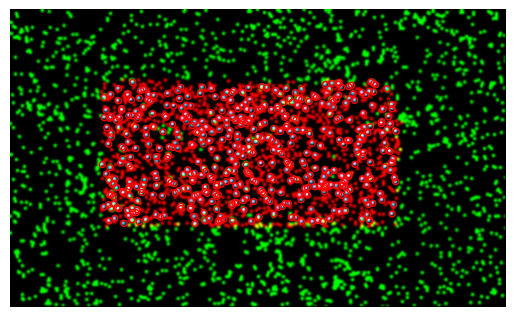

Working on: Pos02120

[-6.56 -7.13]
Matched clusters before transform update:  449
Matched clusters after transform update:  444
Out of  1534  smFRET peaks and  2020  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  21


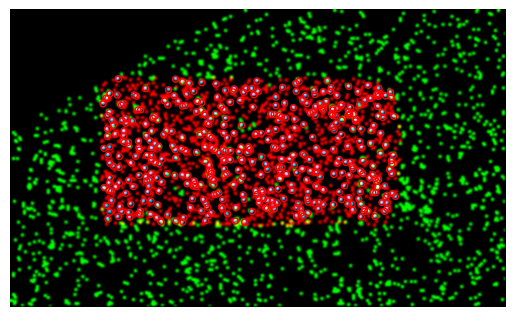

Working on: Pos02121

[-8.23 -9.  ]
Matched clusters before transform update:  166
Matched clusters after transform update:  159
Out of  1612  smFRET peaks and  1101  clusters
Percentage of matched smFRET peaks:  9
Percentage of matched clusters:  14


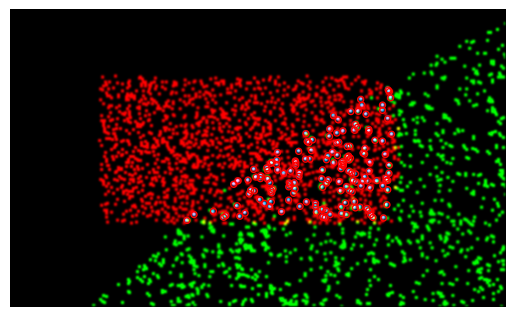

Working on: Pos02122

[ 131.74 -195.27]
Not enough smFRET peaks (<4)


In [211]:
# MAIN CYCLE
os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
#     path1 = os.path.join(path_smFRET,pos,'A_Red','img_000000000.tiff')
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue
        
    if (not os.path.exists(os.path.join(current_direct, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        print('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
#         img_beads_F = io.imread(path1) #reading the stack of images
#         if len(img_beads_F.shape) == 3:
#             if img_beads_F.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
#                 img_beads_F = np.mean(img_beads_F, axis = 2) #averaging by the stack
#             else:
#                 img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
             
#         img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
#         img_beads_F = img_beads_F [256:512, 0:512]
#         img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
#         image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
#         image_array_F = img_as_ubyte(image_array_F)
#         #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

#         image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
#         image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
#         image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
#         image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        seq_t_2 = [sequence_2[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue

        #print(image_array)

        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
#         image_seq = Image.fromarray(image_array_seq_t)
#         image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

#         image_fastq = Image.fromarray(image_array_FQ_t)
#         image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

#         v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
#         if v_max == 0: v_max = np.max(image_array_seq_t)  

#         # Calculating the shift between the FASTQ and cluster images using cross-correlation
#         shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
#         shift = shift[0]
#         print(shift)
#         # Translation of the FASTQ sequences in the FOV to match the cluster image
        x_FQ = np.subtract(x_FQ,X_c)
        y_FQ = np.subtract(y_FQ,Y_c)
#         FQ_shifts.append([X_c-shift[1], Y_c-shift[0]])
#         FQ_shifts_pos.append(pos)
        
#         MAX_centers = blob_detection(
#             image_array_max_t,
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.0001
#         )
#         FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
#         res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
#         FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
#         MAX_centers1 = MAX_centers[np.where(res != inf)]
#         print(FQ_centers_all1)
#         print(MAX_centers1)

#         trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)

#         temp = trFQtoMAX(FQ_centers_all)
#         x_FQ = temp[:,0];
#         y_FQ = temp[:,1];

#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 0, False, 1)
        fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
        fastq_image1.save(os.path.join(pos_direct,pos+'_FQ.png'))
#         max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
#         max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
#         max_image = Image.fromarray(image_array_max_t)
#         max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
#         fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
#         fig, ax = plt.subplots()
#         ax.imshow(fastq_image1)
#         plt.show()


        
        
#         # Calculating the transformation based on automatically-selected beads
#         movie_centers = blob_detection(
#             np.asarray(img_beads_F),
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.1 # was 0.003 before 2024-01-30
#         )

#         seq_centers = blob_detection(
#             image_array_seq_t,
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.0005, # Was 0.00001 for 19/07/2022 and 0.0005
#          )
#         beadsOK = False

            
#         print(beadsOK)    
        # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
        

        img_smFRET = io.imread(path_smFRET_file)

        # Averaging the first 10 frames to select peaks
        if ALEX:
#             img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
            img_t = np.mean(img_smFRET[red_frames,::], axis = 0)
        else:
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
        img_t = img_t.astype("ushort")
        rb_rad = 10

        red = img_t[256:,:]
        green = img_t[:256,:]
        red = red - rolling_ball(red, radius=rb_rad)
        green = green - rolling_ball(green, radius=rb_rad)
        green = transform.warp(green,tr_R2G, preserve_range = True)
        combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
#         fig, ax = plt.subplots()
#         ax.imshow(combined)
        blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=30) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
        CM = []
        r = 3
        [h,w] = red.shape
        n_frames = img_smFRET.shape[0]
        FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        
        for i, blob in enumerate(blobs_log):
            x, y, d = blob
            if x>r and x<(h-r) and y>r and y<(w-r):
                temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                CM.append(np.flip(np.add(temp, [x-r,y-r])))

#                 c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
#                 ax.add_patch(c)
#         ax.set_axis_off()
#         plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
#         plt.show()
        smFRET_centers = np.array(CM)
#         res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
#         movie_centers1 = movie_centers[idx[np.where(res != inf)]]
#         seq_centers1 = seq_centers[np.where(res != inf)]
        
#         if not beadsOK:
            # Calculating the shift between the FASTQ and cluster images using cross-correlation
        smFRET_centers_tr = apriori_tr(smFRET_centers)
#         smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 0, False, 1))
        smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
#         fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 0, False, 1))
        fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
#         fig, ax = plt.subplots()
#         ax.imshow(smFRET_centers_tr_image_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_tr.tif"))

#         fig, ax = plt.subplots()
#         ax.imshow(fastq_image_lib_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(fastq_image_lib_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_FQ_peaks.tif"))

        shift = phase_cross_correlation(fastq_image_lib_array,smFRET_centers_tr_image_array, upsample_factor=100)
        shift = shift[0]
        print(shift)

        rough_tr1 = copy.deepcopy(apriori_tr)
        dx = apriori_tr.params[0,2] + shift[1] # Check sign!
        dy = apriori_tr.params[1,2] + shift[0]
        rough_tr1.params[0,2] = dx
        rough_tr1.params[1,2] = dy

        np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)

        smFRET_centers_tr = rough_tr1(smFRET_centers)
        smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
        fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
#         fig, ax = plt.subplots()
#         ax.imshow(smFRET_centers_tr_image_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_upd_tr.tif"))        
        
        res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
        movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
        seq_centers1 = FQ_centers[np.where(res != inf)]

        if seq_centers1.shape[0]<4:
            print('Not enough smFRET peaks (<4)')
            log_file.write('Not enough smFRET peaks (<4)')
            continue

        tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
        np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
        np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
        log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
        print('Matched clusters before transform update: ',seq_centers1.shape[0])

        res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 3) # Was 4 for 19/07/2022
        centers_matched = smFRET_centers[idx[np.where(res != inf)]]
        idx_t = np.where(res != inf)
        seq_matched = [seq_t[i] for i in idx_t[0]]
        seq_matched_2 = [seq_t_2[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers[idx_t]
        distances_matched = res[idx_t]

        centers_red = centers_matched
        centers_green = tr_R2G(centers_matched)
        r = 3
        # Weed out positions that are too close to the edge
        idx_t = np.where((centers_red[:,0]>rb) & (centers_red[:,0]<(w-rb)) & (centers_red[:,1]>rb) & (centers_red[:,1]<(h-rb))  & 
                         (centers_green[:,0]>rb) & (centers_green[:,0]<(w-rb)) & (centers_green[:,1]>rb) & (centers_green[:,1]<(h-rb)))
        centers_red = centers_red [idx_t]
        centers_green = centers_green [idx_t]
        distances_matched = distances_matched[idx_t]
        seq_matched = [seq_matched[i] for i in idx_t[0]]
        seq_matched_2 = [seq_matched_2[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers_matched[idx_t]
        
        matched_sequences.append(seq_matched)
        matched_sequences_2.append(seq_matched_2)
        matched_centers_red.append(centers_red)
        matched_centers_green.append(centers_green)
        matched_dist.append(distances_matched)
        matched_centers_FQ.append(FQ_centers_matched)
        good_pos.append(pos)
        log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
        log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
        log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
        log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
        print('Matched clusters after transform update: ',len(seq_matched))
        print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
        print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
        print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
        # Saving transformed bead and molecule images for QC
#         img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
#         img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
        img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
        img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
        centers_red_tfd = tr(centers_red)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

        centers_red_tfd = tr(smFRET_centers)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

        img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

        img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        
#         Saving a composite image for quick QC
        fig, ax = plt.subplots()
        QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
        red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
        red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
        red_channel = img_as_ubyte(red_channel)

        green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(green_channel, (0.5, 99.5))
        green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
        green_channel = img_as_ubyte(green_channel)

        blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(blue_channel, (0.5, 99.5))
        blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
        blue_channel = img_as_ubyte(blue_channel)

        QC_composite_array[:,:,0] = red_channel
        QC_composite_array[:,:,1] = green_channel
        QC_composite_array[:,:,2] = blue_channel

        QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
        QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

        ax.imshow(QC_composite)
        for blob in FQ_centers_matched:
            c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
        plt.show()
        

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_sequences_2": matched_sequences_2,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green,
    "matched_distances": matched_dist,
    "matched_FASTQ": matched_centers_FQ,
    "FASTQ_shifts": FQ_shifts
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [212]:
print('Number of matched FOVs: ',len(good_pos))

Number of matched FOVs:  116


In [213]:
# print(x_FQ)

In [214]:
# import copy
# apriori_tr = transform.SimilarityTransform()
# apriori_tr.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
#  [ 2.04811207e-03,  5.98278480e-01,  0],
#  [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# # Centering the tranformation to the x_border and y_border
# delta = 0.5*np.subtract([x_border,y_border],apriori_tr([512,256]))
# dx, dy = delta[0]
# apriori_tr.params[0,2] = dx
# apriori_tr.params[1,2] = dy

# # apriori_tr_inv = transform.SimilarityTransform()
# # apriori_tr_inv.params = np.array([[ 1.67127284e+00,  5.72133913e-03,  0],
# #  [-5.72133913e-03,  1.67127284e+00,  0],
# #  [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# # # Centering the tranformation to the x_border and y_border
# # delta = 0.5*np.subtract([512,256],apriori_tr_inv([x_border,y_border]))
# # dx, dy = delta[0]
# # apriori_tr_inv.params[0,2] = dx
# # apriori_tr_inv.params[1,2] = dy

# #         fig, ax = plt.subplots()
# #         ax.imshow(combined)
# #         blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
# # #             Was 300 for 06/09/2022
# #         CM = []
# #         r = 3
# #         [h,w] = red.shape
# #         n_frames = img_smFRET.shape[0]
# #         FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        
# #         for i, blob in enumerate(blobs_log):
# #             x, y, d = blob
# #             if x>r and x<(h-r) and y>r and y<(w-r):
# #                 temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
# #                 CM.append(np.flip(np.add(temp, [x-r,y-r])))

# #                 c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
# #                 ax.add_patch(c)
# #         ax.set_axis_off()
# #         plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
# #         plt.show()
# smFRET_centers_tr = apriori_tr(smFRET_centers)
# smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
# fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
# fig, ax = plt.subplots()
# ax.imshow(smFRET_centers_tr_image_array)
# plt.show()
# image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
# image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_tr.tif"))

# fig, ax = plt.subplots()
# ax.imshow(fastq_image_lib_array)
# plt.show()
# image_smFRET_tr = Image.fromarray(fastq_image_lib_array)
# image_smFRET_tr.save(os.path.join(pos_direct, pos + "_FQ_peaks.tif"))

# shift = phase_cross_correlation(fastq_image_lib_array,smFRET_centers_tr_image_array)
# shift = shift[0]
# print(shift)
# # print(apriori_tr.params[0,2])
# dx = apriori_tr.params[0,2] + shift[1] # Check sign!
# dy = apriori_tr.params[1,2] + shift[0]
# updated_tr = copy.deepcopy(apriori_tr)
# updated_tr.params[0,2] = dx
# updated_tr.params[1,2] = dy
# # print(apriori_tr.params[0,2])
# print(dx,dy)

# smFRET_centers_tr = updated_tr(smFRET_centers)
# smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
# fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
# fig, ax = plt.subplots()
# ax.imshow(smFRET_centers_tr_image_array)
# plt.show()
# image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
# image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_upd_tr.tif"))


## Extracting traces with median background estimation

In [215]:
# Extracting traces, median BG version
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
# (bacground is calculated as a median of intensities in a rectangular aperture between r and rb)
# a = np.subtract(range(2*rb+1), rb)
at = [[j,i] for i in range(2*rb+1) for j in range(rb-r)]
bt = [[j,i] for i in range(2*rb+1) for j in range(r+rb+1,2*rb+1)]
ct = [[j,i] for i in range(rb-r) for j in range(rb-r,r+rb+1)]
dt = [[j,i] for i in range(r+rb+1,2*rb+1) for j in range(rb-r,r+rb+1)]
idx_bg = np.subtract(np.concatenate([at,bt,ct,dt]), [rb,rb]) # Indexes that define the background aperture

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue
    img_smFRET = io.imread(path_smFRET_file)
    print('Working on: '+pos)

    seq_matched = matched_sequences[i]
    seq_matched_2 = matched_sequences_2[i]
    dist_matched = matched_dist[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for h in range(n_frames):
        if h%100 == 0: print("Working on frame "+str(h))
        red1 = img_smFRET[h,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[h,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             red2 = red1[y0:y1,x0:x1]
#             traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            index = np.add(idx_bg,[int(x), int(y)])
            # Temporary fix for molecules that are too close to the edge
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(red1[index[:,1], index[:,0]])
            red2 = np.subtract(red1[y0:y1,x0:x1], BG)
            traces_red[j,h] = np.sum(np.multiply(weights_red[j],red2))
#             else:
#                 traces_red[j,i] = -10000
                
            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             green2 = green1[y0:y1,x0:x1]
#             traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
            index = np.add(idx_bg,[int(x), int(y)])
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(green1[index[:,1], index[:,0]])
            green2 = np.subtract(green1[y0:y1,x0:x1], BG)
            traces_green[j,h] = np.sum(np.multiply(weights_green[j],green2))
#             else:
#                 traces_green[j,i] = -10000
            

    centers_FQ = matched_centers_FQ[i]
    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched,
        "Seq_2": seq_matched_2,
        "Dist": dist_matched,
        "x": centers_red[:,0],
        "y": centers_red[:,1],
        "x_FQ": centers_FQ[:,0],
        "y_FQ": centers_FQ[:,1]
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

Working on: Pos00324
Working on frame 0
Working on: Pos00325
Working on frame 0
Working on: Pos00326
Working on frame 0
Working on: Pos00327
Working on frame 0
Working on: Pos00328
Working on frame 0
Working on: Pos00437
Working on frame 0
Working on: Pos00438
Working on frame 0
Working on: Pos00439
Working on frame 0
Working on: Pos00440
Working on frame 0
Working on: Pos00441
Working on frame 0
Working on: Pos00442
Working on frame 0
Working on: Pos00443
Working on frame 0
Working on: Pos00444
Working on frame 0
Working on: Pos00579
Working on frame 0
Working on: Pos00580
Working on frame 0
Working on: Pos00581
Working on frame 0
Working on: Pos00582
Working on frame 0
Working on: Pos00583
Working on frame 0
Working on: Pos00584
Working on frame 0
Working on: Pos00585
Working on frame 0
Working on: Pos00586
Working on frame 0
Working on: Pos00693
Working on frame 0
Working on: Pos00694
Working on frame 0
Working on: Pos00695
Working on frame 0
Working on: Pos00696
Working on frame 0


In [23]:
print(len(matched_centers_FQ)
     )
print(i
     )



116
119


## Manual bead selection

In [ ]:
processed_pos = []

In [ ]:
# MAIN CYCLE WITH MANUAL BEAD SELECTION
good_pos = []
matched_sequences = []
matched_centers_red = []
matched_centers_green = []
matched_dist = []
FQ_shifts = []
FQ_shifts_pos = []
matched_centers_FQ = []
# processed_pos = []
os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
    path1 = os.path.join(beads_dir,pos,'A_Red','img_000000000.tiff')
    if os.path.exists(path1)&(not os.path.exists(os.path.join(current_direct, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
        img_beads_F = io.imread(path1) #reading the stack of images
        
        if len(img_beads_F.shape) == 3:
            if img_beads_F.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
                img_beads_F = np.mean(img_beads_F, axis = 2) #averaging by the stack
            else:
                img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
        
        img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
        img_beads_F = img_beads_F [256:512, 0:512]
        img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
        image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
        image_array_F = img_as_ubyte(image_array_F)
        #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

        image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
        image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue

        #print(image_array)

        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
        image_seq = Image.fromarray(image_array_seq_t)
        image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

        image_fastq = Image.fromarray(image_array_FQ_t)
        image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

        v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_seq_t)  

        # Calculating the shift between the FASTQ and cluster images using cross-correlation
        shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
        shift = shift[0]
        print(shift)
        # Translation of the FASTQ sequences in the FOV to match the cluster image
        x_FQ = np.subtract(x_FQ,X_c-shift[1])
        y_FQ = np.subtract(y_FQ,Y_c-shift[0])
        FQ_shifts.append([X_c-shift[1], Y_c-shift[0]])
        FQ_shifts_pos.append(pos)
        
        MAX_centers = blob_detection(
            image_array_max_t,
            min_sigma=1,
            max_sigma=10,
            threshold=0.0001
        )
        FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
        FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
        MAX_centers1 = MAX_centers[np.where(res != inf)]
#         print(FQ_centers_all1)
#         print(MAX_centers1)

        trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)

        temp = trFQtoMAX(FQ_centers_all)
        x_FQ = temp[:,0];
        y_FQ = temp[:,1];

        fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
        fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
        max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
        max_image = Image.fromarray(image_array_max_t)
        max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
#         fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
        fig, ax = plt.subplots()
        ax.imshow(fastq_image1)
        plt.show()

        # Selecting the library sequences for further analysis
        idx = library_index(library_seq, seq_t, 40)
        x_FQ = [x_FQ[i] for i in idx]
        y_FQ = [y_FQ[i] for i in idx]
        seq_t = [seq_t[i] for i in idx]
        

        v_min, v_max = np.percentile(image_array_F, (0, 100))
        if v_max == 0: v_max = np.max(image_array_F)
        v_max = 0.1*v_max #adjust the percent (10% in this run) as necessary
        better_contrast_image_array = exposure.rescale_intensity(image_array_F, in_range=(v_min, v_max))
        better_contrast_img = Image.fromarray(better_contrast_image_array)
        better_contrast_img.save(pos_direct + '/'+pos + '_contr.tif')
        better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        #reading by cv2 to make possible circles in color
        v_min, v_max = np.percentile(image_array_seq_t, (0, 100))
        if v_max == 0: v_max = np.max(image_array_seq_t)
        v_max = 0.1*v_max
        better_contrast_image_array_2 = exposure.rescale_intensity(image_array_seq_t, in_range=(v_min, v_max))
        better_contrast_img_2 = Image.fromarray(better_contrast_image_array_2)
        better_contrast_img_2.save(pos_direct + '/'+''+ pos+'_contr_MIN_seq_stack.tif')
        better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif') 
        FRET_coord = []
        seq_coord = []
#         cv2.namedWindow(pos) 
#         cv2.namedWindow(pos+'_seq') 
        cv2.namedWindow(pos, cv2.WINDOW_NORMAL) 
        cv2.namedWindow(pos+'_seq',cv2.WINDOW_NORMAL) 

        cv2.setMouseCallback(pos,  click_event_FRET)
        cv2.setMouseCallback(pos+'_seq',  click_event_seq)
        cv2.resizeWindow(pos, 2*x_border,2*y_border)
        cv2.resizeWindow(pos+'_seq', 2*x_border,2*y_border)
        #cv2.setMouseCallback('image1',  click_event)
        while(1):
            cv2.imshow(pos,better_contrast_img)
            cv2.imshow(pos+'_seq',better_contrast_img_2)
            k = cv2.waitKey(1)&0xFF 
            #if cv2.waitKey(20) & 0xFF == 27: #press Esc to quit
            if k == ord('q'): # Press 'q' to finish
                if len(seq_coord) == len(FRET_coord):
                    break
                else:
                    counter = 0
                    cv2.destroyAllWindows()
                    FRET_coord = []
                    seq_coord = []
                    cv2.namedWindow(pos, cv2.WINDOW_NORMAL) 
                    cv2.namedWindow(pos+'_seq',cv2.WINDOW_NORMAL) 
                    cv2.setMouseCallback(pos,  click_event_FRET)
                    cv2.setMouseCallback(pos+'_seq',  click_event_seq)
                    cv2.resizeWindow(pos, 2*x_border,2*y_border)
                    cv2.resizeWindow(pos+'_seq', 2*x_border,2*y_border)
                    better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
                    better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
            elif k == ord('r'): # Press 'r' to restart
                counter = 0
                cv2.destroyAllWindows()
                FRET_coord = []
                seq_coord = []
                cv2.namedWindow(pos, cv2.WINDOW_NORMAL) 
                cv2.namedWindow(pos+'_seq',cv2.WINDOW_NORMAL) 
                cv2.setMouseCallback(pos,  click_event_FRET)
                cv2.setMouseCallback(pos+'_seq',  click_event_seq)
                cv2.resizeWindow(pos, 2*x_border,2*y_border)
                cv2.resizeWindow(pos+'_seq', 2*x_border,2*y_border)
                better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
                better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        
        cv2.destroyAllWindows()
        
        # If the user selected less than three beads we switch to the next FOV
        if len(seq_coord) < 3:
            log_file.write('Not enough (<3) manually selected beads\n')
            continue
        
        seq_coord = np.reshape(seq_coord,(int((counter+1)/2), 2))
        FRET_coord = np.reshape(FRET_coord,(int((counter+1)/2), 2))
        FRET_coord = apriori_tr_inv(FRET_coord)
        result = np.concatenate ((FRET_coord, seq_coord), axis = 0)
        np.save(pos_direct + '/' + pos+'_manual_coord', result)
        
        rough_tr1 = transform.estimate_transform("similarity", src=FRET_coord, dst=seq_coord)
        np.save(os.path.join(pos_direct, pos + "_man_bead_tr"), rough_tr1)
        # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
        
        if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
            path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
        elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
            path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
        elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
            path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
        else:
            continue

        img_smFRET = io.imread(path_smFRET_file)

        # Averaging the first 10 frames to select peaks
        if ALEX:
            img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
        else:
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
        img_t = img_t.astype("ushort")
        rb_rad = 10

        red = img_t[256:,:]
        green = img_t[:256,:]
        red = red - rolling_ball(red, radius=rb_rad)
        green = green - rolling_ball(green, radius=rb_rad)
        green = transform.warp(green,tr_R2G, preserve_range = True)
        combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
        fig, ax = plt.subplots()
        ax.imshow(combined)
        blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
        CM = []
        r = 3
        [h,w] = red.shape
        n_frames = img_smFRET.shape[0]

        for i, blob in enumerate(blobs_log):
            x, y, d = blob
            if x>r and x<(h-r) and y>r and y<(w-r):
                temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                CM.append(np.flip(np.add(temp, [x-r,y-r])))

                c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
        plt.show()


        smFRET_centers = np.array(CM)
        FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
        movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
        seq_centers1 = FQ_centers[np.where(res != inf)]

        if seq_centers1.shape[0]<4:
            print('Not enough smFRET peaks (<4)')
            log_file.write('Not enough smFRET peaks (<4)')
            continue

        tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
        np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
        np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
        log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
        print('Matched clusters before transform update: ',seq_centers1.shape[0])

        res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 3) # Was 4 for 19/07/2022
        centers_matched = smFRET_centers[idx[np.where(res != inf)]]
        idx_t = np.where(res != inf)
        seq_matched = [seq_t[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers[idx_t]
        distances_matched = res[idx_t]


        centers_red = centers_matched
        centers_green = tr_R2G(centers_matched)
        r = 3
        # Weed out positions that are too close to the edge
        idx_t = np.where((centers_red[:,0]>rb) & (centers_red[:,0]<(w-rb)) & (centers_red[:,1]>rb) & (centers_red[:,1]<(h-rb))  & 
                         (centers_green[:,0]>rb) & (centers_green[:,0]<(w-rb)) & (centers_green[:,1]>rb) & (centers_green[:,1]<(h-rb)))
        centers_red = centers_red [idx_t]
        centers_green = centers_green [idx_t]
        seq_matched = [seq_matched[i] for i in idx_t[0]]
        distances_matched = distances_matched[idx_t]

        matched_sequences.append(seq_matched)
        matched_centers_red.append(centers_red)
        matched_centers_green.append(centers_green)
        matched_dist.append(distances_matched)
        matched_centers_FQ.append(FQ_centers_matched)
        good_pos.append(pos)
        log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
        log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
        log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
        log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
        print('Matched clusters after transform update: ',len(seq_matched))
        print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
        print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
        print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
        # Saving transformed bead and molecule images for QC
        img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
        img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
        img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
        img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
        centers_red_tfd = tr(centers_red)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

        centers_red_tfd = tr(smFRET_centers)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

        img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

        img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        
#         Saving a composite image for quick QC
        fig, ax = plt.subplots()
        QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
        red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
        red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
        red_channel = img_as_ubyte(red_channel)

        green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(green_channel, (0.5, 99.5))
        green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
        green_channel = img_as_ubyte(green_channel)

        blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(blue_channel, (0.5, 99.5))
        blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
        blue_channel = img_as_ubyte(blue_channel)

        QC_composite_array[:,:,0] = red_channel
        QC_composite_array[:,:,1] = green_channel
        QC_composite_array[:,:,2] = blue_channel

        QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
        QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

        ax.imshow(QC_composite)
        for blob in FQ_centers_matched:
            c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
        plt.show()
        

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green,
    "matched_distances": matched_dist,
    "FASTQ_x": x_coord,
    "FASTQ_Y": Y_coord,
    "FASTQ_shifts": FQ_shifts
}

savemat(os.path.join(current_direct, "good_pos_man.mat"), mdict1)


In [ ]:
print('Number of matched FOVs: ',len(good_pos))

In [ ]:
# Extracting traces, median BG version
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
# (bacground is calculated as a median of intensities in a rectangular aperture between r and rb)
# a = np.subtract(range(2*rb+1), rb)
at = [[j,i] for i in range(2*rb+1) for j in range(rb-r)]
bt = [[j,i] for i in range(2*rb+1) for j in range(r+rb+1,2*rb+1)]
ct = [[j,i] for i in range(rb-r) for j in range(rb-r,r+rb+1)]
dt = [[j,i] for i in range(r+rb+1,2*rb+1) for j in range(rb-r,r+rb+1)]
idx_bg = np.subtract(np.concatenate([at,bt,ct,dt]), [rb,rb]) # Indexes that define the background aperture

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
#     img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    else:
        continue
    img_smFRET = io.imread(path_smFRET_file)
    
    seq_matched = matched_sequences[i]
    dist_matched = matched_dist[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for i in range(n_frames):
        if i%100 == 0: print("Working on frame "+str(i))
        red1 = img_smFRET[i,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[i,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             red2 = red1[y0:y1,x0:x1]
#             traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            index = np.add(idx_bg,[int(x), int(y)])
            # Temporary fix for molecules that are too close to the edge
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(red1[index[:,1], index[:,0]])
            red2 = np.subtract(red1[y0:y1,x0:x1], BG)
            traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))
#             else:
#                 traces_red[j,i] = -10000
                
            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             green2 = green1[y0:y1,x0:x1]
#             traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
            index = np.add(idx_bg,[int(x), int(y)])
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(green1[index[:,1], index[:,0]])
            green2 = np.subtract(green1[y0:y1,x0:x1], BG)
            traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
#             else:
#                 traces_green[j,i] = -10000
            


    centers_FQ = matched_centers_FQ[i]
    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched,
        "Dist": dist_matched,
        "x": centers_red[:,0],
        "y": centers_red[:,1],
        "x_FQ": centers_FQ[:,0],
        "y_FQ": centers_FQ[:,1]
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

# END OF THE MAIN CYCLE

In [ ]:
# fig, ax = plt.subplots()
# ax.imshow(image_array_F)

In [ ]:
# img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        
# fig, ax = plt.subplots()
# ax.imshow(img_centers_red_tfd)

# for blob in FQ_centers_matched:
#     c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
#     ax.add_patch(c)
# ax.set_axis_off()
# # plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
# plt.show()
# # a[:,256:] = 50
# # a[:,0:10] = 200
# # print(a[1,1])
# # a = exposure.rescale_intensity(a)
# # a = img_as_ubyte(a)
# # print(a[1,1])
# # print(a[1,11])
# # percentiles = np.percentile(a, (0.5, 99.5))
# # a1 = exposure.rescale_intensity(a, in_range=tuple(percentiles))
# # b = np.zeros((256,512,3), dtype=np.uint8)
# # b[:,:,0] = a1
# # b[:,:,1] = a1
# # # print(a1[0,400])
# # fig, ax = plt.subplots()
# # # QC_composite = Image.fromarray(b)
# # QC_composite = Image.fromarray(b, mode = 'RGB')
# # ax.imshow(QC_composite)
# # plt.show()
# # # print(np.asarray(QC_composite))


In [ ]:
# print(FQ_centers_matched)

In [ ]:
idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
x_FQ = [x_coord[i] for i in idx]
y_FQ = [y_coord[i] for i in idx]
seq_t = [sequence[i] for i in idx]
print(len(seq_t))


# Selecting the library sequences for further analysis
idx = library_index(library_seq, seq_t, 40)
x_FQ = [x_FQ[i] for i in idx]
y_FQ = [y_FQ[i] for i in idx]
seq_t = [seq_t[i] for i in idx]
print(len(seq_t))

In [ ]:
cv2.destroyAllWindows()


In [ ]:
print(uknmatchstars_coord
     )
print(refmatchstars_coord)
print(apriori_tr_inv(uknmatchstars_coord))
rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)

print(rough_tr1.params)

In [ ]:
fig, ax = plt.subplots()
ax.imshow(combined)
blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
CM = []
r = 3
[h,w] = red.shape
n_frames = img_smFRET.shape[0]

for i, blob in enumerate(blobs_log):
    x, y, d = blob
    if x>r and x<(h-r) and y>r and y<(w-r):
        temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
        CM.append(np.flip(np.add(temp, [x-r,y-r])))

        c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
        ax.add_patch(c)
ax.set_axis_off()
plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
plt.show()

In [ ]:
smFRET_centers = np.array(CM)
FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 8)
movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
seq_centers1 = FQ_centers[np.where(res != inf)]
print(FQ_centers)


In [ ]:
# DO NOT RUN BY DEFAULT! Removing the last position.
matched_sequences = matched_sequences[:-1]
matched_centers_red = matched_centers_red[:-1]
matched_centers_green = matched_centers_green[:-1]
good_pos = good_pos[:-1]

In [ ]:
src = rough_tf1(smFRET_centers)
dst = FQ_centers
tree = spatial.KDTree(src)
print(len(src), len(dst))
res, idx = tree.query(dst, k=1, distance_upper_bound=8)
for i in range(0, len(idx)):
#     i = 0
    idx_t = np.argwhere(idx == idx[i])
    # print(len(idx_t))
    # print(idx)
    if len(idx_t) > 1:
        res_t = [res[j] for j in idx_t]
        if res[i] > min(res_t): res[i] = inf

idx_t1 = np.argwhere(res < inf)
print(len(idx_t1))

In [ ]:
# fastq_image = generate_img(y_coord,x_coord, 0, 0, max_y, max_x, 1, True, 1)
# image_array_FQ1 = np.asarray(fastq_image)
# idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+330) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+170)]
# x_FQ = [x_coord[i] for i in idx]
# y_FQ = [y_coord[i] for i in idx]
# x_FQ = np.subtract(x_FQ,X_c-shift[1])
# y_FQ = np.subtract(y_FQ,Y_c-shift[0])
# fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, 170, 330, 1, True, 1)
# # image_array_FQ_t = image_array_FQ1[ Y_c:Y_c+170, X_c:X_c+330]
# # fig, ax = plt.subplots()
# # ax.imshow(image_array_FQ_t)
# # plt.show()
# fig, ax = plt.subplots()
# ax.imshow(fastq_image1)
# plt.show()
# print(X_c,Y_c, shift)
# print(min(x_FQ),max(x_FQ), min(y_FQ), max(y_FQ))

In [ ]:
print(len(good_pos), len(matched_sequences), len(matched_centers_red), len(matched_centers_green))

In [ ]:
# Extracting traces Standard version

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
#     img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))
    img_smFRET = io.imread(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff'))
    seq_matched = matched_sequences[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for i in range(n_frames):
        if i%100 == 0: print("Working on frame "+str(i))
        red1 = img_smFRET[i,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[i,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            red2 = red1[y0:y1,x0:x1]
            traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            green2 = green1[y0:y1,x0:x1]
            traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))


    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

# Main pipeline ends here

In [ ]:
# # Skip by default! Figuring out the displacement for tiles.
# file_path = fd.askopenfilename(title = "Choose the position list")

# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][0]['X'] for P in POS]
# posY = [P['DEVICES'][0]['Y'] for P in POS]
# # print(min(posX), max(posX), min(posY), max(posY))
# upper_left_um_x = min(posX)
# upper_left_um_y = max(posY)
# file_path_coords = fd.askopenfilename(title = "Choose the coordinate .npy file", initialdir = os.path.dirname(file_path))
# coords_t = np.load(file_path_coords)
# n_t = int(len(coords_t)/2)
# coords_t_seq = coords_t[:n_t,:]
# coords_t_FRET = coords_t[n_t:,:]
# [deltax, deltay] = np.mean(np.subtract(coords_t_seq,coords_t_FRET), axis = 0)
# print(deltax,deltay)
# print(upper_left_um_x, upper_left_um_y)

In [ ]:

    root = tk.Tk()
    root.attributes("-topmost", True)
    root.withdraw()
    labels_res = []
    posX_res = []
    posY_res = []
    file_path = fd.askopenfilename(title = "Choose the position list", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/parameter")
    pos_file = open(file_path)
    data = json.load(pos_file)
    POS = data['POSITIONS']

    labels = [P['LABEL'] for P in POS]
    posX = [P['DEVICES'][0]['X'] for P in POS]
    posY = [P['DEVICES'][0]['Y'] for P in POS]
    
    for i,x in enumerate(labels):
        x = int(2329 + (posX[i] - 28522.9)/0.34)
        y = int(2042 - (posY[i] + 1313.3)/0.34)
        if (x > 0 ) and (y > 0):
            if (y+y_border<2866) and (x+x_border < 2944) :
                labels_res.append (labels[i])
                posX_res.append (posX[i])
                posY_res.append( posY[i])
    
    
    X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos279']
    Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos279']
    #X_c, Y_c = scaling_seq(X_c[0], Y_c[0])

In [ ]:
app_dir = "C:/Users/panf/Documents/Muscle_intermediates/test_folder_4/"
for pos in labels_res :
    for current_dir,dirs, files in os.walk(app_dir) :
        for el in files: 
            print(el.split('.')[-2])
            print(pos)
            if el.split('.')[-2] == pos:
                img1 = io.imread(current_dir + '/' + el) #reading the stack of images
                
                img1 = img1.astype("ushort") #turn from float format to ushort
                img1 = img1 [256:512, 0:512]
                plt.figure()
                plt.imshow(img1)


In [ ]:
X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos148']
Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos148']

x_c, y_c = scaling_seq (X_c[0], Y_c[0])
print (x_c, y_c)

In [ ]:
import math
seq_coord = np.empty([0,2], dtype=int)
fret_coord = np.empty([0,2], dtype=int)
current_direct = "D:/nanobio/uppsala/muscle/Muscle_Misha/beads/"
for current_dir,dirs, files in os.walk(current_direct) :
        for el in files: 
            coord = np.load(current_dir + '/' + el) 
            length = len(coord)
            fret_coord = np.concatenate ((fret_coord, coord[0:int(length/2)] ), axis = 0 )
            seq_coord = np.concatenate ((seq_coord, coord[int(length/2):length] ), axis = 0 )

seq_coord = seq_coord * 1.7
#print(seq_coord)
#print(fret_coord)
distance1 = []
length = len(seq_coord)
print (length)
res = np.concatenate ((seq_coord, fret_coord), axis = 1)
for i in range(length):
    
    distance1.append(math.sqrt(math.pow((seq_coord[i][0] - fret_coord[i][0]),2) + math.pow((seq_coord[i][1] - fret_coord[i][1]),2)))
    print(math.sqrt(math.pow((seq_coord[i][0] - fret_coord[i][0]),2) + math.pow((seq_coord[i][1] - fret_coord[i][1]),2)))


In [ ]:
processed_pos = []

In [ ]:
# ALTERNATIVE MAIN CYCLE to reanalyse the data with existing manual bead coordinates
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
    path1 = os.path.join(beads_dir,pos+'.tiff')
    if os.path.exists(path1)&(not os.path.exists(os.path.join(path_smFRET, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
        img_beads_F = io.imread(path1) #reading the stack of images
        if len(img_beads_F.shape) == 3:
            img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
        img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
        img_beads_F = img_beads_F [256:512, 0:512]
        img_beads_F = img_beads_F - si.restoration.rolling_ball(img_beads_F, radius=rb_rad)
        image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
        image_array_F = img_as_ubyte(image_array_F)
        #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

        image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
        image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue



#                 for i in range (len(sequence)):
#                     if (x_coord[i] >= X_c) and (x_coord[i] <= X_c+330): 
#                         if (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+170):
#                                 data['sequence'].append({
#                                                      'X': x_coord[i],
#                                                      'Y': y_coord[i],
#                                                      'sequence': sequence[i]
#                                                         })

        #print(image_array)
        v_min, v_max = np.percentile(image_array_F, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_F)
        better_contrast_image_array = exposure.rescale_intensity(image_array_F, in_range=(v_min, v_max))
        better_contrast_img = Image.fromarray(better_contrast_image_array)
        better_contrast_img.save(pos_direct + '/'+pos + '_contr.tif')
        better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
        image_seq = Image.fromarray(image_array_seq_t)
        image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

        image_fastq = Image.fromarray(image_array_FQ_t)
#         plt.figure()
#         plt.imshow(image_fastq)
        image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

        v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_seq_t)
        better_contrast_image_array_2 = exposure.rescale_intensity(image_array_seq_t, in_range=(v_min, v_max))
        better_contrast_img_2 = Image.fromarray(better_contrast_image_array_2)
        better_contrast_img_2.save(pos_direct + '/'+''+ pos+'_contr_MIN_seq_stack.tif')
        better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')     

#         plt.figure()
#         plt.imshow( Image.fromarray(image_array_seq_t))     
        
        # User clicks of beads with "q" for exit when done
        FRET_coord = []
        seq_coord = []
#         cv2.namedWindow(pos) 
#         cv2.namedWindow(pos+'_seq') 
#         cv2.setMouseCallback(pos,  click_event_FRET)
#         cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#         #cv2.setMouseCallback('image1',  click_event)
#         while(1):
#             cv2.imshow(pos,better_contrast_img)
#             cv2.imshow(pos+'_seq',better_contrast_img_2)
#             k = cv2.waitKey(1)&0xFF 
#             #if cv2.waitKey(20) & 0xFF == 27: #press Esc to quit
#             if k == ord('q'): # Press 'q' to finish
#                 if len(seq_coord) == len(FRET_coord):
#                     break
#                 else:
#                     counter = 0
#                     cv2.destroyAllWindows()
#                     FRET_coord = []
#                     seq_coord = []
#                     cv2.namedWindow(pos) 
#                     cv2.namedWindow(pos+'_seq') 
#                     cv2.setMouseCallback(pos,  click_event_FRET)
#                     cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#                     better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
#                     better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
#             elif k == ord('r'): # Press 'r' to restart
#                 counter = 0
#                 cv2.destroyAllWindows()
#                 FRET_coord = []
#                 seq_coord = []
#                 cv2.namedWindow(pos) 
#                 cv2.namedWindow(pos+'_seq') 
#                 cv2.setMouseCallback(pos,  click_event_FRET)
#                 cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#                 better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
#                 better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        
#         cv2.destroyAllWindows()
        
        # If the user selected at least three beads we proceed with analysis
        if os.path.exists(pos_direct + '/' + pos+'_manual_coord.npy'): 
            result = np.load(pos_direct + '/' + pos+'_manual_coord.npy')
#             seq_coord = np.reshape(seq_coord,(int((counter+1)/2), 2))
            
#             FRET_coord = np.reshape(FRET_coord,(int((counter+1)/2), 2))
#             FRET_coord = apriori_tr_inv(FRET_coord)
            split = int(len(result)/2)
            FRET_coord = result[:split,:]
            seq_coord = result[split:,:]
#             np.save(pos_direct + '/' + pos+'_manual_coord', result)
            
            # Calculating the shift between the FASTQ and cluster images using cross-correlation
            shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
            shift = shift[0]
            # Translation of the FASTQ sequences in the FOV to match the cluster image
            x_FQ = np.subtract(x_FQ,X_c-shift[1])
            y_FQ = np.subtract(y_FQ,Y_c-shift[0])
            max_image = Image.fromarray(image_array_max_t)
            max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
            fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
            fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
            fig, ax = plt.subplots()
            ax.imshow(fastq_image1)
            plt.show()


            # Selecting the library sequences for further analysis
            idx = library_index(library_seq, seq_t, 40)
            x_FQ = [x_FQ[i] for i in idx]
            y_FQ = [y_FQ[i] for i in idx]
            seq_t = [seq_t[i] for i in idx]

            # Calculating the first rough transformation based on manually-selected beads
            rough_tr = transform.estimate_transform("similarity", src=FRET_coord, dst=seq_coord)
            np.save(os.path.join(pos_direct, pos + "_man_bead_tr"), rough_tr)
            # Refining the transformation based on automatically-selected beads
            movie_centers = blob_detection(
                np.asarray(img_beads_F),
                min_sigma=1,
                max_sigma=10,
                threshold=0.01
            )

            seq_centers = blob_detection(
                image_array_seq_t,
                min_sigma=1,
                max_sigma=10,
                threshold=0.0001, # Was 0.00001 for 19/07/2022; 0.0001 for 06/09/2022
             )
            
            res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
            movie_centers1 = movie_centers[idx[np.where(res != inf)]]
            seq_centers1 = seq_centers[np.where(res != inf)]
            print('Automatically matched beads: ',seq_centers1.shape[0])
            if seq_centers1.shape[0] >2:
                log_file.write("Detected " + str(seq_centers1.shape[0]) + " matched beads. Updating the manual transformation\n")                
                rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
            else:
                log_file.write("""Not enough (<3) automatically detected and matched beads to update the initial
                               transformation estimate based on manually selected beads\n""")
                rough_tr1 = rough_tr

            np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)
            # Reading the smFRET movie
            img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))

            # Averaging the first 10 frames to select peaks
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
            img_t = img_t.astype("ushort")
            rb_rad = 10
            #print(img1[10:20,10:20])
            #img = np.zeros([20,20])
            #img[10,5] = 1000
            red = img_t[256:,:]
            green = img_t[:256,:]
            red = red - si.restoration.rolling_ball(red, radius=rb_rad)
            green = green - si.restoration.rolling_ball(green, radius=rb_rad)
            green = transform.warp(green,tr_R2G, preserve_range = True)
            combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
            fig, ax = plt.subplots()
            ax.imshow(combined)
            blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022; 300 for 06/09/2022
            CM = []
            r = 3
            [h,w] = red.shape
            n_frames = img_smFRET.shape[0]

            for i, blob in enumerate(blobs_log):
                x, y, d = blob
                if x>r and x<(h-r) and y>r and y<(w-r):
                    temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                    CM.append(np.flip(np.add(temp, [x-r,y-r])))

                    c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                    ax.add_patch(c)
            ax.set_axis_off()
            plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
            plt.show()
            
            
            smFRET_centers = np.array(CM)
            FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
            res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 8)
            movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
            seq_centers1 = FQ_centers[np.where(res != inf)]

            # Calculating the polynomial tranformation between FRET peaks and clusters
            
#             if seq_centers1.shape[0]>=9:
#                 order = 2
#             if seq_centers1.shape[0]>=4:
#                 order = 1
#             else: continue
            if seq_centers1.shape[0]<4: 
                log_file.write('Not enough smFRET peaks (<4)')
                continue
            
            tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
            tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
            np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
            np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
            log_file.write('Matched clusters before polywarp: ' + str(seq_centers1.shape[0])+'\n')
            print('Matched clusters before polywarp: ',seq_centers1.shape[0])
            
#             kx,ky = Polywarp.polywarp(seq_centers1[:,0],seq_centers1[:,1],movie_centers1[:,0],movie_centers1[:,1],degree=order)
# #             print(kx)
# #             print(ky)
#             tr = transform.PolynomialTransform()
#             #tr.estimate(src,dst,order = 2)

#             order1 = 2*order
#             pidx = 0
#             par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#             for j in range(order1 + 1):
#                 for i in range(j + 1):
#                     if (j-i)<=order and i<=order:
#                         par[0, pidx] = kx[j - i,i]
#                         par[1, pidx] = ky[j - i,i]
#                     else:
#                         par[0, pidx] = 0
#                         par[1, pidx] = 0
#                     pidx += 1
#             tr.params = par        

#             kx,ky = Polywarp.polywarp(movie_centers1[:,0],movie_centers1[:,1],seq_centers1[:,0],seq_centers1[:,1],degree=order)
#             tr_inv = transform.PolynomialTransform()
#             #tr.estimate(src,dst,order = 2)

#             order1 = 2*order
#             pidx = 0
#             par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#             for j in range(order1 + 1):
#                 for i in range(j + 1):
#                     if (j-i)<=order and i<=order:
#                         par[0, pidx] = kx[j - i,i]
#                         par[1, pidx] = ky[j - i,i]
#                     else:
#                         par[0, pidx] = 0
#                         par[1, pidx] = 0
#                     pidx += 1
#             tr_inv.params = par

            res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 8) # Was 4 for 19/07/2022
            centers_matched = smFRET_centers[idx[np.where(res != inf)]]
            idx_t = np.where(res != inf)
            seq_matched = [seq_t[i] for i in idx_t[0]]
            FQ_centers_matched = FQ_centers[idx_t]
            
            
            centers_red = centers_matched
            centers_green = tr_R2G(centers_matched)
            r = 3
            # Weed out positions that are too close to the edge
            idx_t = np.where((centers_red[:,0]>r) & (centers_red[:,0]<(w-r)) & (centers_red[:,1]>r) & (centers_red[:,1]<(h-r))  & 
                             (centers_green[:,0]>r) & (centers_green[:,0]<(w-r)) & (centers_green[:,1]>r) & (centers_green[:,1]<(h-r)))
            centers_red = centers_red [idx_t]
            centers_green = centers_green [idx_t]
            seq_matched = [seq_matched[i] for i in idx_t[0]]
            
            matched_sequences.append(seq_matched)
            matched_centers_red.append(centers_red)
            matched_centers_green.append(centers_green)
            good_pos.append(pos)
            log_file.write('Matched clusters after polywarp: ' + str(len(seq_matched))+'\n')
            log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
            log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
            log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
            print('Matched clusters after polywarp: ',len(seq_matched))
            print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
            print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
            print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
            # Saving transformed bead and molecule images for QC
            img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
            img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
            img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
            img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
            centers_red_tfd = tr(centers_red)
            img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))
            
            centers_red_tfd = tr(smFRET_centers)
            img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))
            
            img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))
                    
            img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        else:   log_file.write('Not enough manually matched beads\n')

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [ ]:
print(Y_c,X_c
     )

In [ ]:
# from skimage.measure import ransac
# from sklearn.linear_model import RANSACRegressor

# # print(movie_centers)
# # print(seq_centers)

# """ 
#     Wrapped polynomial transformation for Ransac using.
# """
# class QuadPolyTrans(transform.PolynomialTransform):
#     def estimate(*data):
#         return transform.PolynomialTransform.estimate(*data, order=2)


# class CubicPolyTrans(transform.PolynomialTransform):
#     def estimate(*data):
#         return transform.PolynomialTransform.estimate(*data, order=3)
# model, inliers = ransac(
#     (FQ_centers_all1, MAX_centers1),
#     transform.SimilarityTransform,
#     20,
#     2,
#     initial_inliers=np.ones(len(MAX_centers1), dtype=bool),
#     stop_probability=0.999
# )
# print(model.params)
# print(inliers)
# FQ_centers_all2 = FQ_centers_all1[np.where(inliers == True)]
# MAX_centers2 = MAX_centers1[np.where(inliers == True)]



# print('Residuals after poly (order = '+str(order)+') transformation: ',mean_squared_error(model(FQ_centers_all1), MAX_centers1))
# print('Residuals before transformation: ',mean_squared_error(FQ_centers_all1, MAX_centers1))


# order = 3
# kx,ky = Polywarp.polywarp(MAX_centers2[:,0],MAX_centers2[:,1],FQ_centers_all2[:,0],FQ_centers_all2[:,1],degree=order)
# print(kx)
# print(ky)
# trFQtoMAX = transform.PolynomialTransform()
# #tr.estimate(src,dst,order = 2)
# order1 = 2*order
# pidx = 0
# par = np.zeros([2,int((order1+1)*(order1+2)/2)])
# for j in range(order1 + 1):
#     for i in range(j + 1):
#         if (j-i)<=order and i<=order:
#             par[0, pidx] = kx[j - i,i]
#             par[1, pidx] = ky[j - i,i]
#         else:
#             par[0, pidx] = 0
#             par[1, pidx] = 0
#         pidx += 1
# trFQtoMAX.params = par  
# print('Residuals after poly (order = '+str(order)+') transformation: ',mean_squared_error(trFQtoMAX(FQ_centers_all1), MAX_centers1))
# print('Residuals before transformation: ',mean_squared_error(FQ_centers_all1, MAX_centers1))

In [ ]:
# MAIN CYCLE test
processed_pos = []

os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
# for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
path1 = os.path.join(beads_dir,pos,'A_Red','img_000000000.tiff')
if os.path.exists(path1)&(not os.path.exists(os.path.join(path_smFRET, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []

    processed_pos.append(pos)
    pos_direct = os.path.join(current_direct, pos)
    os.makedirs(pos_direct, exist_ok=True)
    log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
    log_file.write('Working on: '+ pos+'\n')
    FRET_coord = []
    seq_coord = []
    point = []
    counter = 0
    rb_rad = 10
    img_beads_F = io.imread(path1) #reading the stack of images
    if len(img_beads_F.shape) == 3:
        img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
    img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
    img_beads_F = img_beads_F [256:512, 0:512]
    img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
    image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
    image_array_F = img_as_ubyte(image_array_F)
    #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
    #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

    image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)

    idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
    X_c = [posX_res[i] for i in idx]
    Y_c = [posY_res[i] for i in idx]

    X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
    point.append(X_c)
    point.append(Y_c)
    point = np.array(point)
    image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
    image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
    image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
    idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
    x_FQ = [x_coord[i] for i in idx]
    y_FQ = [y_coord[i] for i in idx]
    seq_t = [sequence[i] for i in idx]
    if len(seq_t)<100:
        log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
#         continue

    #print(image_array)

    #reading by cv2 to make possible circles in color
    #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
    #img_array = img_as_int(img)
    # displaying the image
    # setting mouse handler for the image
    # and calling the click_event() function
    image_seq = Image.fromarray(image_array_seq_t)
    image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

    image_fastq = Image.fromarray(image_array_FQ_t)
    image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

    v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
    if v_max == 0: v_max = np.max(image_array_seq_t)  

    # Calculating the shift between the FASTQ and cluster images using cross-correlation
    shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
    shift = shift[0]
    # Translation of the FASTQ sequences in the FOV to match the cluster image
    x_FQ = np.subtract(x_FQ,X_c-shift[1])
    y_FQ = np.subtract(y_FQ,Y_c-shift[0])
    max_image = Image.fromarray(image_array_max_t)
    max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))

#     fastq_image_ = generate_img(y_coord,x_coord, 0, 0, max_y, max_x, 1, True, 1)
    MAX_centers = blob_detection(
        image_array_max_t,
        min_sigma=1,
        max_sigma=10,
        threshold=0.0001
    )
    FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
    res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
    FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
    MAX_centers1 = MAX_centers[np.where(res != inf)]
    print(FQ_centers_all1)
    print(MAX_centers1)
    
    trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)
#     order = 4
#     kx,ky = Polywarp.polywarp(MAX_centers1[:,0],MAX_centers1[:,1],FQ_centers_all1[:,0],FQ_centers_all1[:,1],degree=order)
#     print(kx)
#     print(ky)
#     trFQtoMAX = transform.PolynomialTransform()
#     #tr.estimate(src,dst,order = 2)
#     order1 = 2*order
#     pidx = 0
#     par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#     for j in range(order1 + 1):
#         for i in range(j + 1):
#             if (j-i)<=order and i<=order:
#                 par[0, pidx] = kx[j - i,i]
#                 par[1, pidx] = ky[j - i,i]
#             else:
#                 par[0, pidx] = 0
#                 par[1, pidx] = 0
#             pidx += 1
#     trFQtoMAX.params = par  
    print('Residuals after poly (order = '+str(order)+') transformation: ',mean_squared_error(trFQtoMAX(FQ_centers_all1), MAX_centers1))
    print('Residuals before transformation: ',mean_squared_error(FQ_centers_all1, MAX_centers1))
    
    
    temp = trFQtoMAX(FQ_centers_all)
    x_FQ = temp[:,0];
    y_FQ = temp[:,1];
    
    
    fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
    fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
    max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
    max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
    fig, ax = plt.subplots()
    ax.imshow(fastq_image1)
    plt.show()

    # Selecting the library sequences for further analysis
    idx = [i for i,x in enumerate(seq_t) if library_seq in x]
    x_FQ = [x_FQ[i] for i in idx]
    y_FQ = [y_FQ[i] for i in idx]
    seq_t = [seq_t[i] for i in idx]

    # Calculating the transformation based on automatically-selected beads
    movie_centers = blob_detection(
        np.asarray(img_beads_F),
        min_sigma=1,
        max_sigma=10,
        threshold=0.01
    )

    seq_centers = blob_detection(
        image_array_seq_t,
        min_sigma=1,
        max_sigma=10,
        threshold=0.001, # Was 0.00001 for 19/07/2022
     )

    a = run(seq_centers, apriori_tr(movie_centers))

    uknmatchstars_coord = []
    refmatchstars_coord = []
    if len(a[0].refmatchstars) >= 3:
        for i in range (len(a[0].refmatchstars)):
            uknmatchstars_coord.append(a[0].uknmatchstars[i].x)
            uknmatchstars_coord.append(a[0].uknmatchstars[i].y)
            refmatchstars_coord.append(a[0].refmatchstars[i].x)
            refmatchstars_coord.append(a[0].refmatchstars[i].y)

        refmatchstars_coord = np.array(refmatchstars_coord)
        uknmatchstars_coord = np.array(uknmatchstars_coord)

        refmatchstars_coord = np.reshape ( refmatchstars_coord, ( int(len(a[0].refmatchstars)), 2 ) )
        uknmatchstars_coord = np.reshape ( uknmatchstars_coord, ( int(len(a[0].uknmatchstars)), 2 ) )
        result_coord = np.concatenate ((refmatchstars_coord,uknmatchstars_coord ), axis = 0)
        print (pos+"\n", result_coord )
        np.save (os.path.join(pos_direct, pos + "_matching_beads"), result_coord)
    else:
        log_file.write("""Not enough (<3) automatically detected and matched beads to update the initial
                       transformation estimate based on manually selected beads\n""")
#         continue
#         res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
#         movie_centers1 = movie_centers[idx[np.where(res != inf)]]
#         seq_centers1 = seq_centers[np.where(res != inf)]
    movie_centers1 = apriori_tr_inv(uknmatchstars_coord)
    seq_centers1 = refmatchstars_coord
    print('Automatically matched beads: ',seq_centers1.shape[0])
    rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
    np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)
    # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
    path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
#     if not os.path.exists(path_smFRET_file):
#         continue

    img_smFRET = io.imread(path_smFRET_file)

    # Averaging the first 10 frames to select peaks
    img_t = np.mean(img_smFRET[0:10,::], axis = 0)
    img_t = img_t.astype("ushort")
    rb_rad = 10

    red = img_t[256:,:]
    green = img_t[:256,:]
    red = red - rolling_ball(red, radius=rb_rad)
    green = green - rolling_ball(green, radius=rb_rad)
    green = transform.warp(green,tr_R2G, preserve_range = True)
    combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
    fig, ax = plt.subplots()
    ax.imshow(combined)
    blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
    CM = []
    r = 3
    [h,w] = red.shape
    n_frames = img_smFRET.shape[0]

    for i, blob in enumerate(blobs_log):
        x, y, d = blob
        if x>r and x<(h-r) and y>r and y<(w-r):
            temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
            CM.append(np.flip(np.add(temp, [x-r,y-r])))

            c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
    ax.set_axis_off()
    plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
    plt.show()


    smFRET_centers = np.array(CM)
    FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
    res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
    movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
    seq_centers1 = FQ_centers[np.where(res != inf)]

    if seq_centers1.shape[0]<4:
        print('Not enough smFRET peaks (<4)')
        log_file.write('Not enough smFRET peaks (<4)')
#         continue
    
    order = 2
    kx,ky = Polywarp.polywarp(seq_centers1[:,0],seq_centers1[:,1],movie_centers1[:,0],movie_centers1[:,1],degree=order)
    print(kx)
    print(ky)
    tr = transform.PolynomialTransform()
    #tr.estimate(src,dst,order = 2)

    order1 = 2*order
    pidx = 0
    par = np.zeros([2,int((order1+1)*(order1+2)/2)])
    for j in range(order1 + 1):
        for i in range(j + 1):
            if (j-i)<=order and i<=order:
                par[0, pidx] = kx[j - i,i]
                par[1, pidx] = ky[j - i,i]
            else:
                par[0, pidx] = 0
                par[1, pidx] = 0
            pidx += 1
    tr.params = par        

    kx,ky = Polywarp.polywarp(movie_centers1[:,0],movie_centers1[:,1],seq_centers1[:,0],seq_centers1[:,1],degree=order)
    tr_inv = transform.PolynomialTransform()
    #tr.estimate(src,dst,order = 2)

    order1 = 2*order
    pidx = 0
    par = np.zeros([2,int((order1+1)*(order1+2)/2)])
    for j in range(order1 + 1):
        for i in range(j + 1):
            if (j-i)<=order and i<=order:
                par[0, pidx] = kx[j - i,i]
                par[1, pidx] = ky[j - i,i]
            else:
                par[0, pidx] = 0
                par[1, pidx] = 0
            pidx += 1
    tr_inv.params = par    
#     tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
#     tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
    np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
    np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
    log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
    print('Matched clusters before transform update: ',seq_centers1.shape[0])

    res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 1) # Was 4 for 19/07/2022
    centers_matched = smFRET_centers[idx[np.where(res != inf)]]
    idx_t = np.where(res != inf)
    seq_matched = [seq_t[i] for i in idx_t[0]]
    FQ_centers_matched = FQ_centers[idx_t]


    centers_red = centers_matched
    centers_green = tr_R2G(centers_matched)
    r = 3
    # Weed out positions that are too close to the edge
    idx_t = np.where((centers_red[:,0]>r) & (centers_red[:,0]<(w-r)) & (centers_red[:,1]>r) & (centers_red[:,1]<(h-r))  & 
                     (centers_green[:,0]>r) & (centers_green[:,0]<(w-r)) & (centers_green[:,1]>r) & (centers_green[:,1]<(h-r)))
    centers_red = centers_red [idx_t]
    centers_green = centers_green [idx_t]
    seq_matched = [seq_matched[i] for i in idx_t[0]]

    matched_sequences.append(seq_matched)
    matched_centers_red.append(centers_red)
    matched_centers_green.append(centers_green)
    good_pos.append(pos)
    log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
    log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
    log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
    log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
    print('Matched clusters after transform update: ',len(seq_matched))
    print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
    print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
    print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
    # Saving transformed bead and molecule images for QC
    img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
    img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
    img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
    img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
    centers_red_tfd = tr(centers_red)
    img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

    centers_red_tfd = tr(smFRET_centers)
    img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

    img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

    img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
    img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))

#         Saving a composite image for quick QC
    fig, ax = plt.subplots()
    QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
    red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
    percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
    red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
    red_channel = img_as_ubyte(red_channel)

    green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
    percentiles = np.percentile(green_channel, (0.5, 99.5))
    green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
    green_channel = img_as_ubyte(green_channel)

    blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
    percentiles = np.percentile(blue_channel, (0.5, 99.5))
    blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
    blue_channel = img_as_ubyte(blue_channel)

    QC_composite_array[:,:,0] = red_channel
    QC_composite_array[:,:,1] = green_channel
    QC_composite_array[:,:,2] = blue_channel

    QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
    QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

    ax.imshow(QC_composite)
    for blob in FQ_centers_matched:
        c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
        ax.add_patch(c)
    ax.set_axis_off()
    plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
    plt.show()


# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)
